In [1]:
#in this notebook, we perform a naive sequential training over the three tasks defined in "NIH-statistics"

In [2]:
import sys
sys.path.append('/home/marina/continual_fairness/')

In [3]:
from sklearn.metrics import roc_auc_score
import torch
import torchxrayvision as xrv
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms
import numpy as np
from torch.utils.data import Dataset, DataLoader, Subset
import matplotlib.pyplot as plt
from src.data.utils import ThreeChannelTransform
from src.data.utils import CustomDataset
from src.data.utils import OutputCapturer
from src.data.dataset import NIH
from src.data.dataset import CheXpert
from sklearn.metrics import roc_auc_score
import time
import os
from PIL import Image
import pandas as pd
import random

In [4]:
device = torch.device('cuda:1')

In [5]:
path_to_csv = "/home/marina/continual_fairness/d_nih_aug.csv"

In [6]:
d_nih_aug_csv = pd.read_csv(path_to_csv)

In [7]:
train_indices_file_nih = '/home/marina/continual_fairness/datasets_indices/train_indices_nih.txt'
val_indices_file_nih = '/home/marina/continual_fairness/datasets_indices/val_indices_nih.txt'
test_indices_file_nih = '/home/marina/continual_fairness/datasets_indices/test_indices_nih.txt'

In [8]:
#we initialize train_indices, val_indices and test_indices with the indices in the three text files
#train_indices contains 80% of the patients of the original dataset, val_indices 10% and test_indices 10%
def read_indices_from_txt(file_path):
    indices = []
    with open(file_path, 'r') as file:
        for line in file:
            index = int(line.strip())
            indices.append(index)
    return indices

In [9]:
train_indices_list_nih = read_indices_from_txt(train_indices_file_nih)
val_indices_list_nih = read_indices_from_txt(val_indices_file_nih)
test_indices_list_nih = read_indices_from_txt(test_indices_file_nih)

In [10]:
# Create a new DataFrame with row indices starting from zero to 89000
train_df_nih = d_nih_aug_csv[d_nih_aug_csv.index.isin(train_indices_list_nih)].reset_index(drop=True)
val_df_nih = d_nih_aug_csv[d_nih_aug_csv["index"].isin(val_indices_list_nih)].reset_index(drop=True)
test_df_nih = d_nih_aug_csv[d_nih_aug_csv["index"].isin(test_indices_list_nih)].reset_index(drop=True)

In [11]:
normalize_nih = transforms.Normalize(mean=[0.485, 0.456, 0.406],std=[0.229, 0.224, 0.225])

# Define your transformation pipeline
train_transform_nih = transforms.Compose([transforms.RandomHorizontalFlip(),
                                transforms.RandomRotation(10),
                                transforms.Resize((256,256)),
                                transforms.CenterCrop(256),
                                transforms.ToTensor(),
                                normalize_nih])
val_transform_nih = transforms.Compose([transforms.Resize((256,256)),
                                     transforms.CenterCrop(256),
                                     transforms.ToTensor(),
                                     normalize_nih])
test_transform_nih = transforms.Compose([transforms.Resize((256,256)),
                                     transforms.CenterCrop(256),
                                     transforms.ToTensor(),
                                     normalize_nih])

In [12]:
path_image_nih = "/home/marina/continual_fairness/dataset/archive/"

In [13]:
train_dataset_nih = NIH(train_df_nih, path_image=path_image_nih, transform=train_transform_nih)
val_dataset_nih = NIH(val_df_nih, path_image=path_image_nih, transform=val_transform_nih)
test_dataset_nih = NIH(test_df_nih, path_image=path_image_nih, transform=test_transform_nih)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 1., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


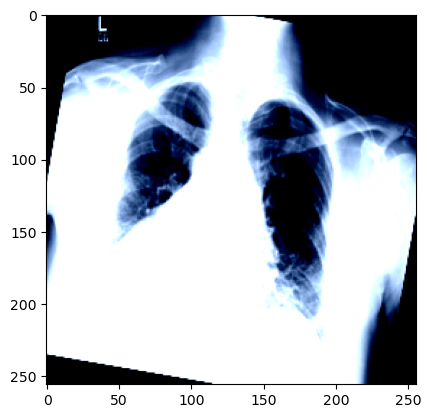

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])


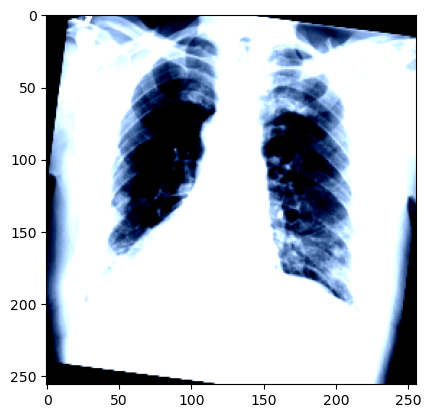

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 1., 0., 0., 0.,
        0., 0., 0.])


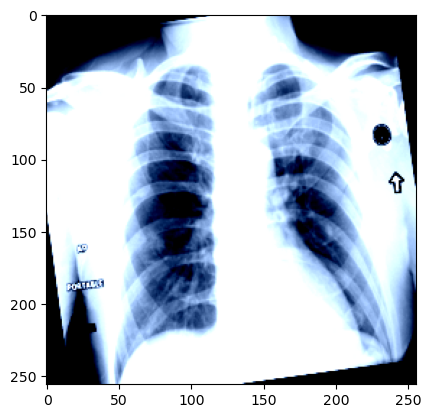

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


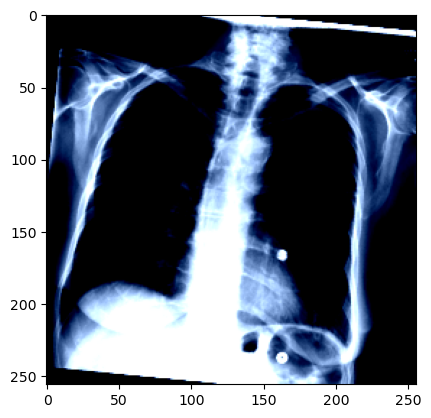

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])


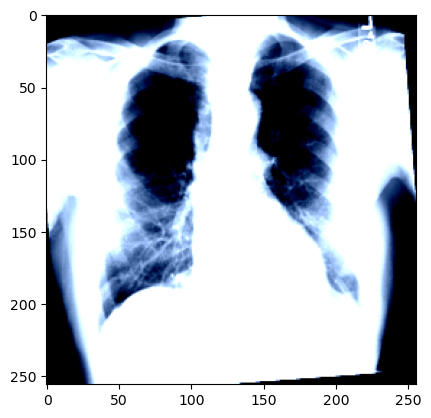

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])


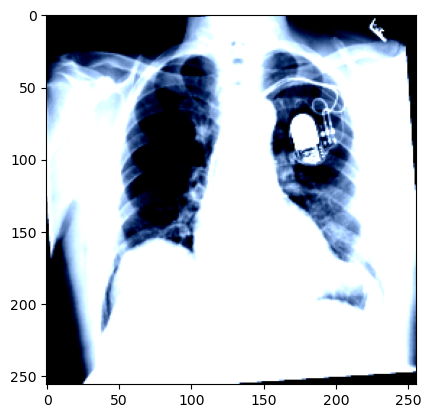

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


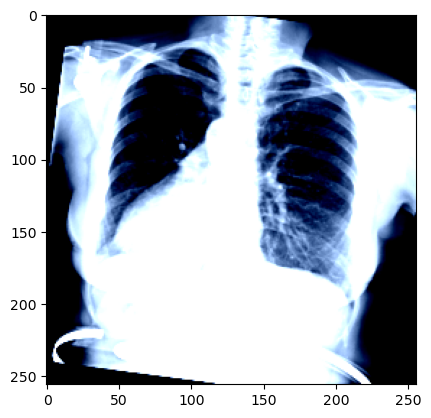

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


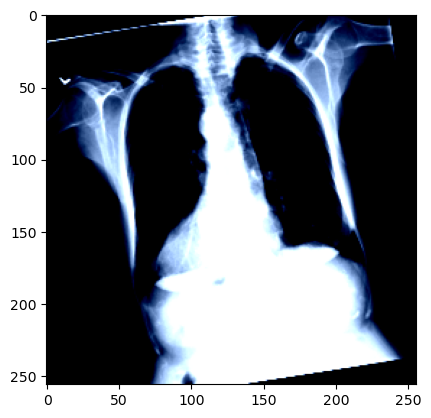

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])


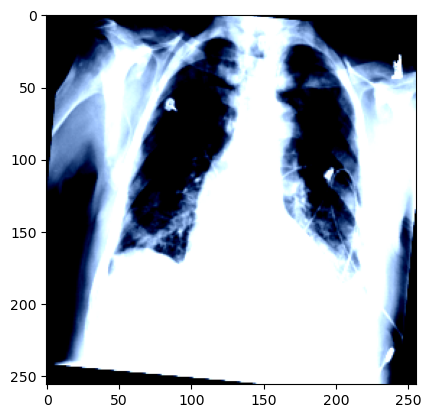

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0.,
        0., 0., 0.])


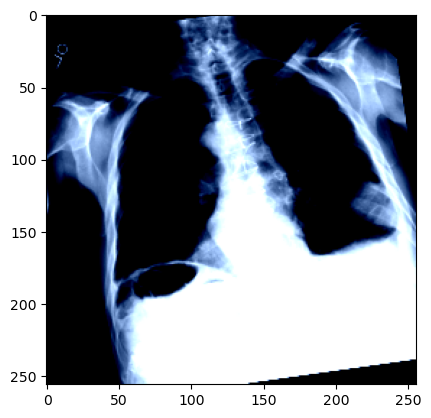

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 1., 0.])


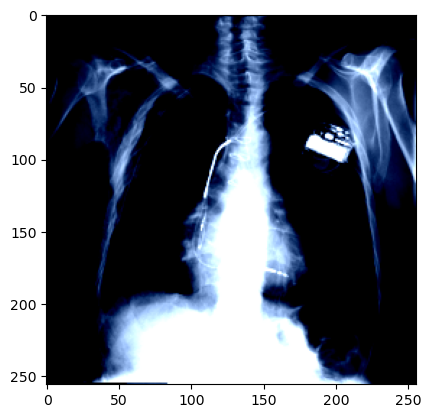

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])


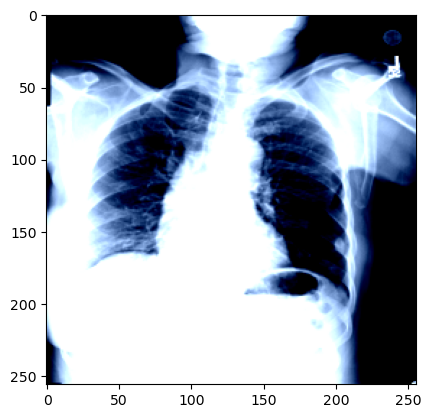

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])


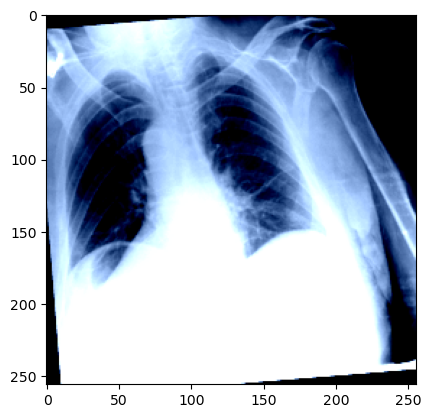

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])


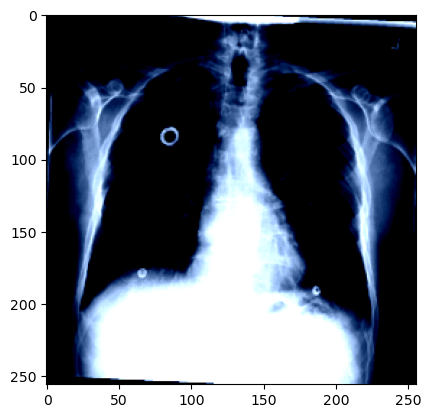

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])


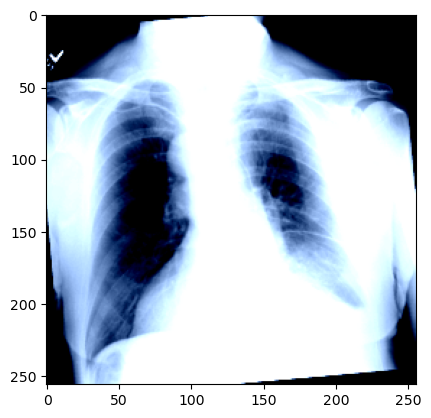

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])


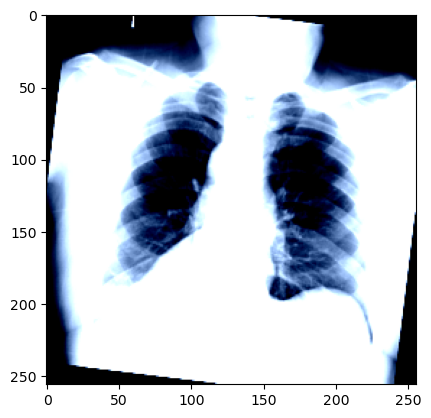

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 1., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0.,
        0., 0., 0.])


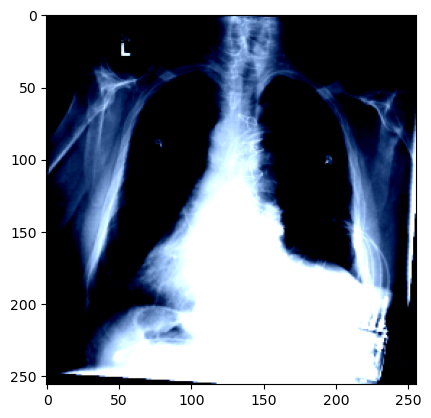

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 1., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


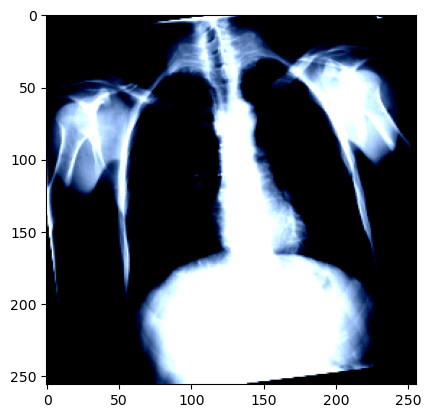

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 1., 1., 0., 0., 0.,
        0., 0., 0.])


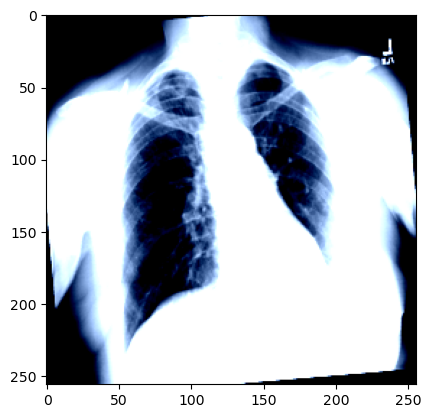

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


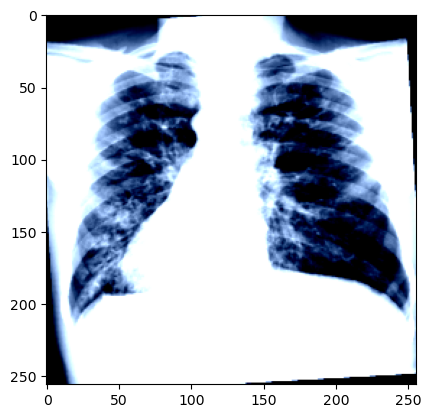

In [14]:
for i in range(20):
    image = train_dataset_nih[i][0]
    image = np.transpose(image, (1, 2, 0))  # Transpose to (256, 256, 3) for color display
    target = train_dataset_nih[i][1]
    print(target)
    pathology = train_df_nih["Finding Labels"][i]
    index = train_df_nih["index"][i]
    plt.imshow(image)
    plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


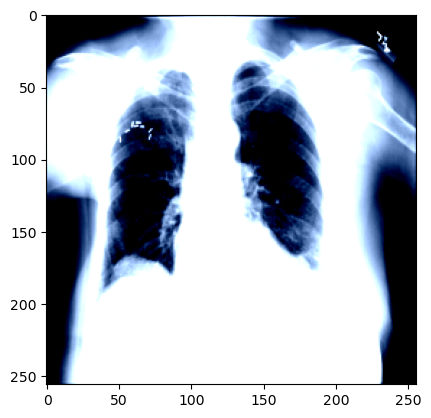

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


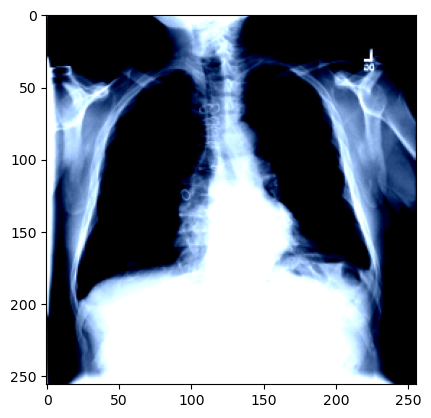

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


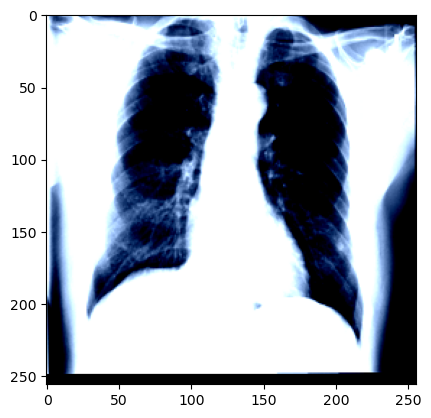

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


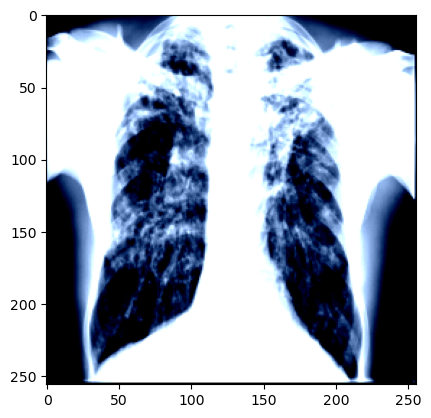

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 1., 1., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


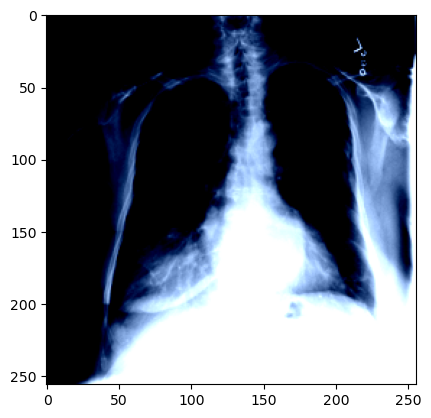

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])


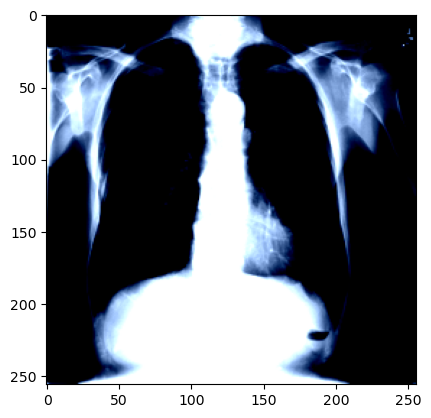

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


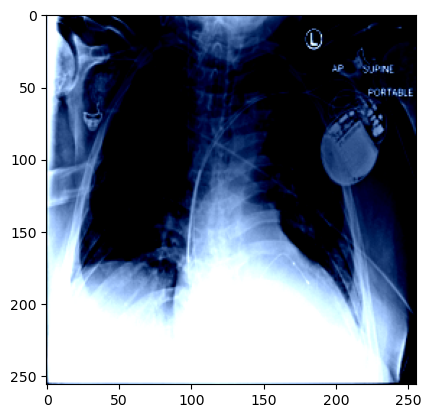

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


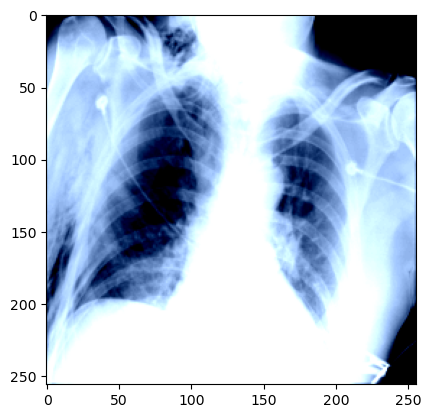

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


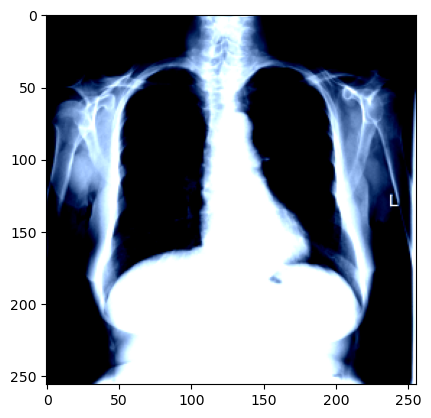

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])


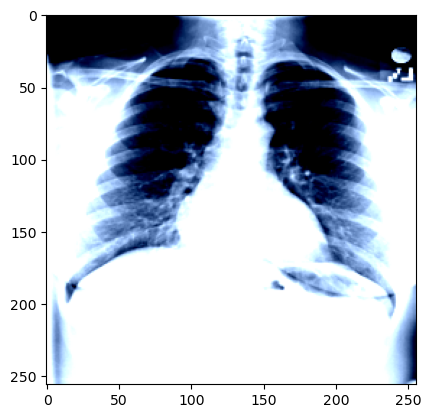

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0.,
        0., 0., 0.])


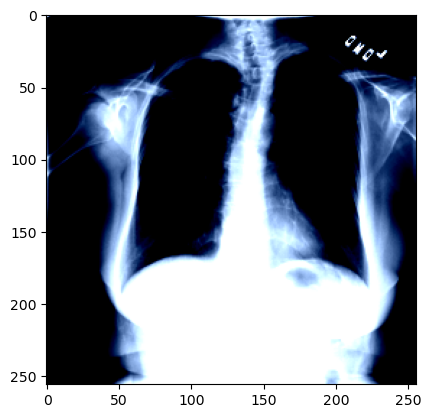

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0.,
        0., 0., 0.])


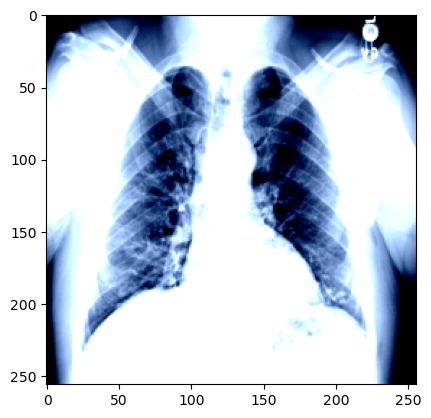

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])


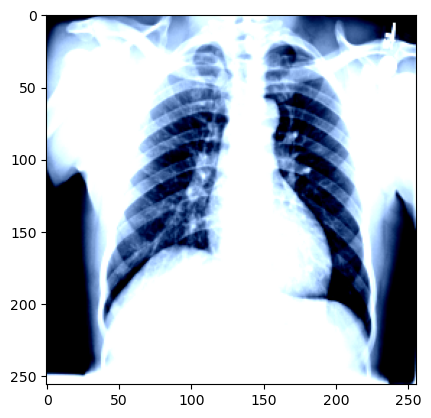

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])


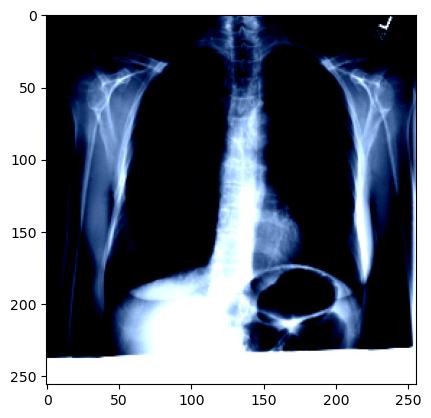

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


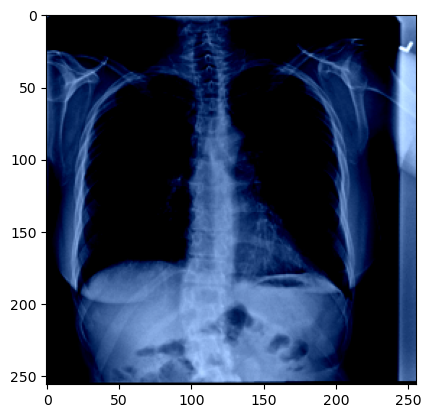

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])


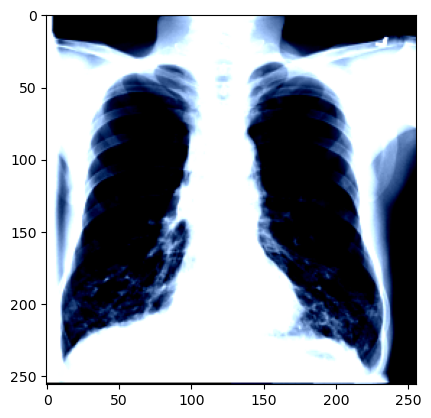

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])


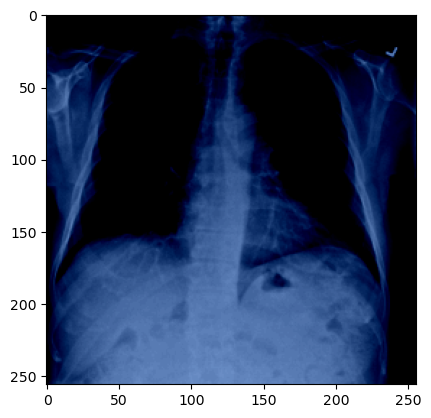

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


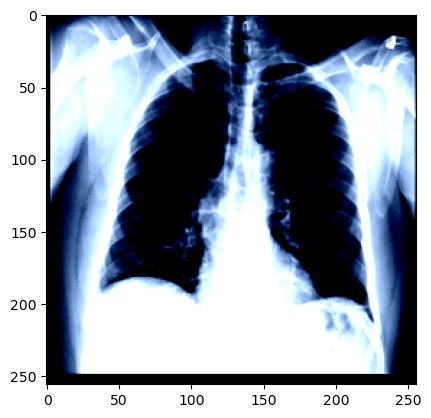

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 1., 0.,
        0., 0., 0.])


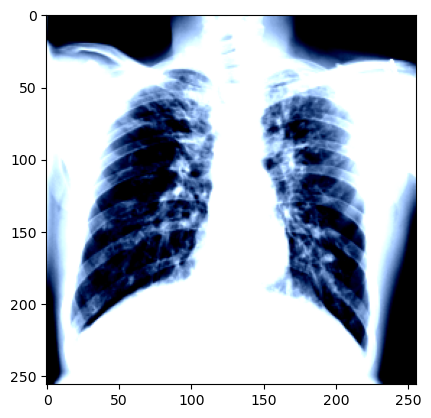

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


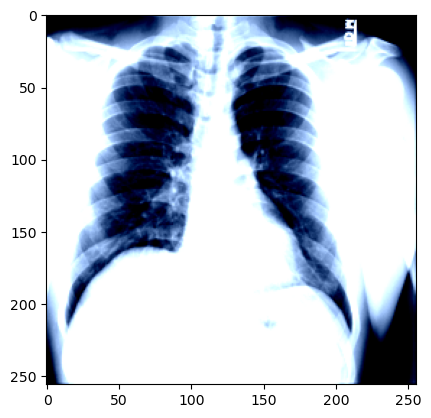

In [15]:
for i in range(20):
    image = val_dataset_nih[i][0]
    image = np.transpose(image, (1, 2, 0))  # Transpose to (256, 256, 3) for color display
    target = val_dataset_nih[i][1]
    print(target)
    pathology = val_df_nih["Finding Labels"][i]
    index = val_df_nih["index"][i]
    plt.imshow(image)
    plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


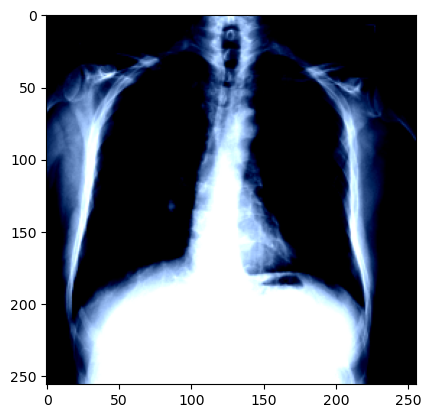

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


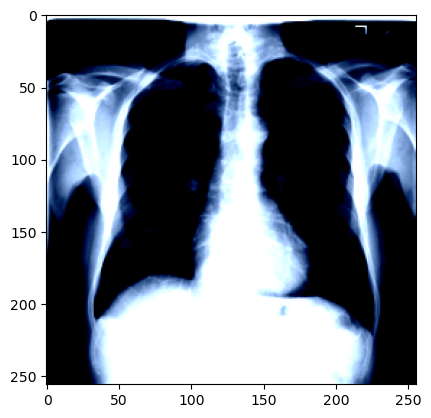

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


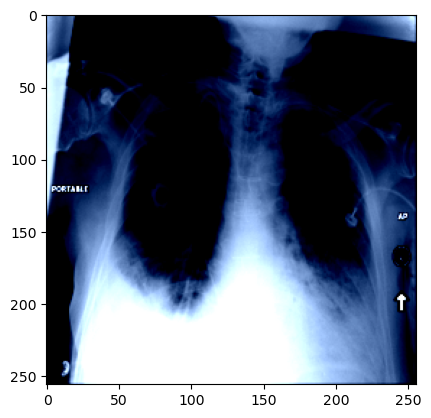

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


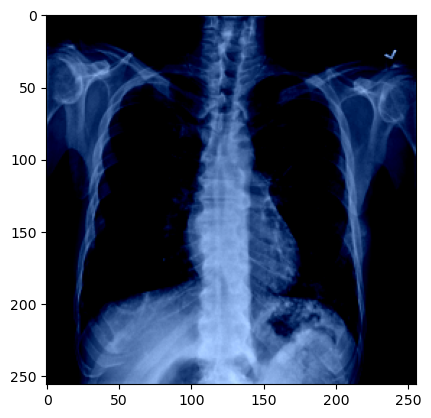

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


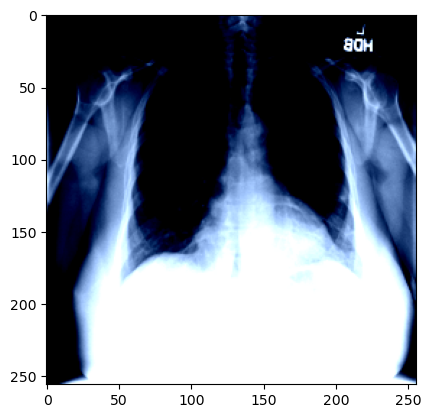

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])


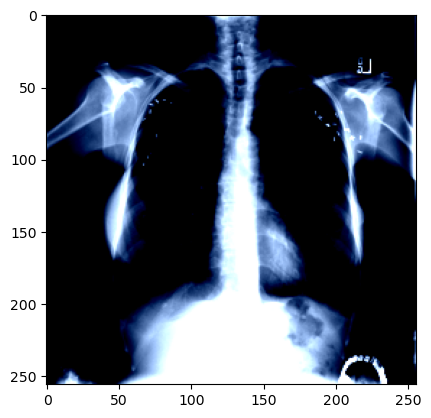

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


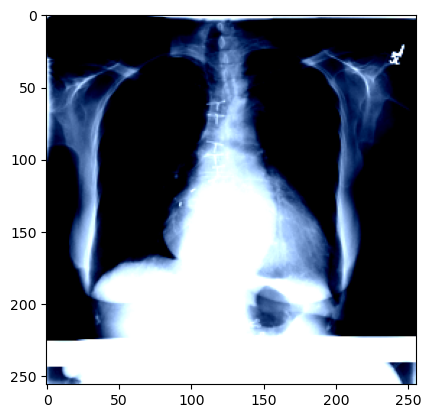

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])


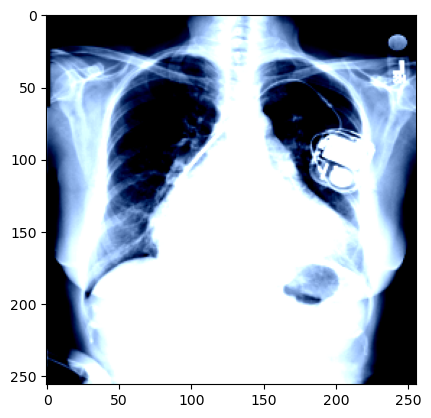

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])


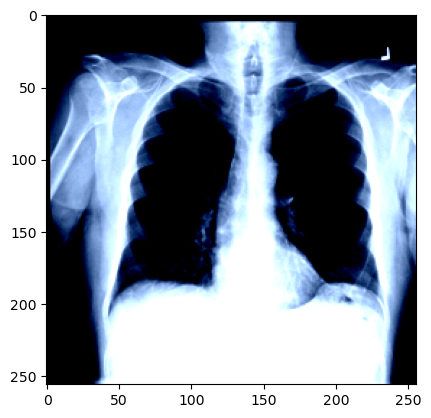

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 1., 0., 0., 0.,
        0., 0., 0.])


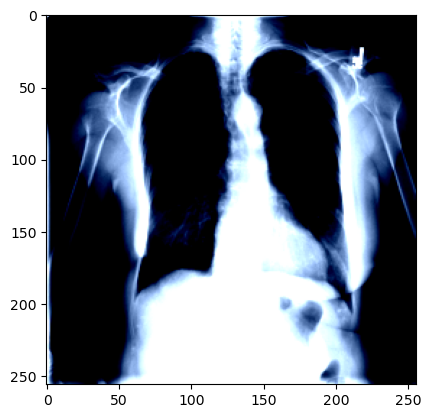

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 1., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


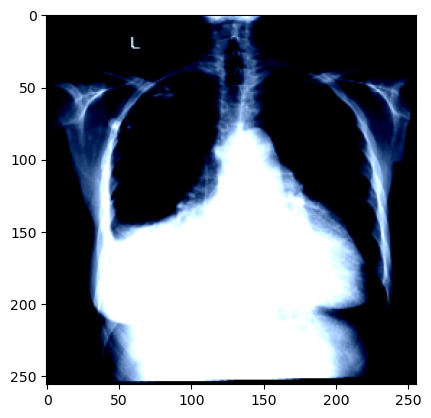

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


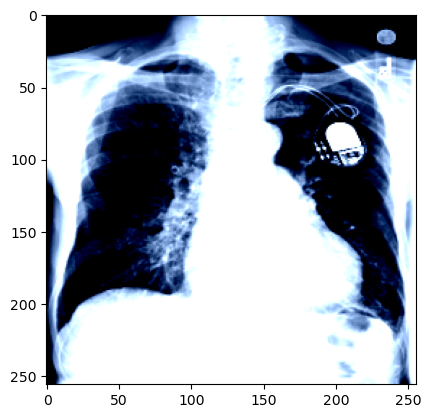

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


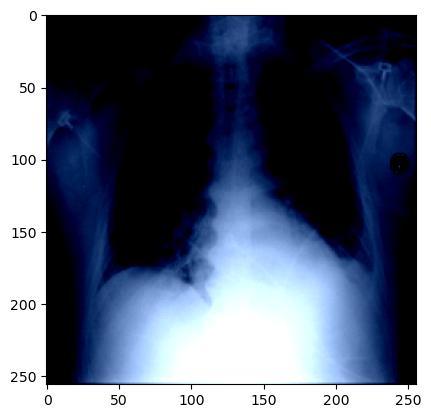

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])


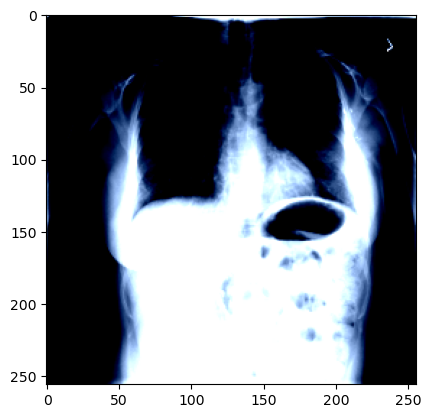

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


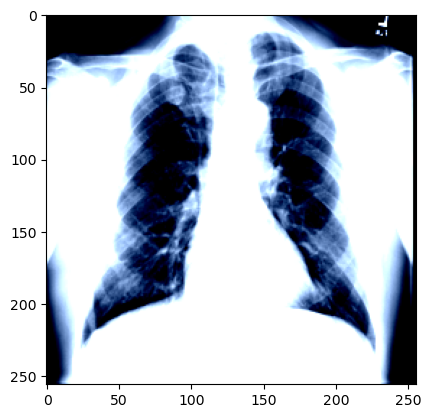

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 1., 0.])


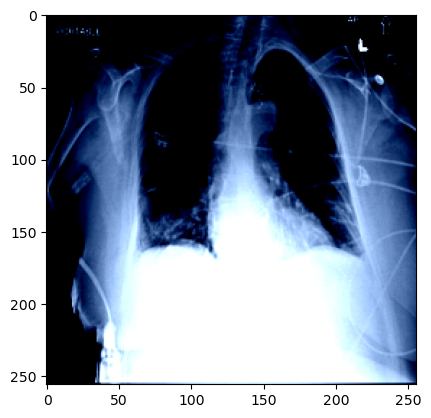

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])


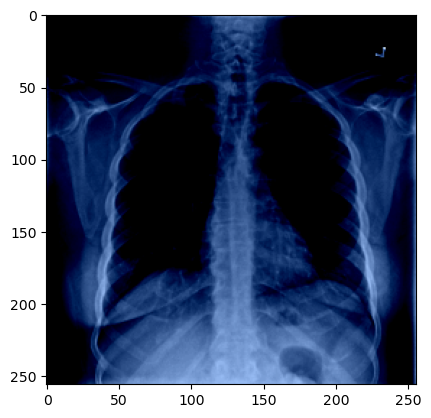

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])


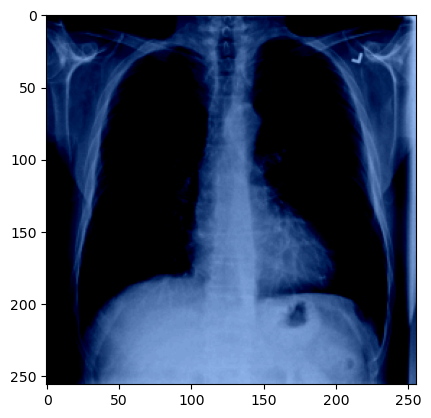

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


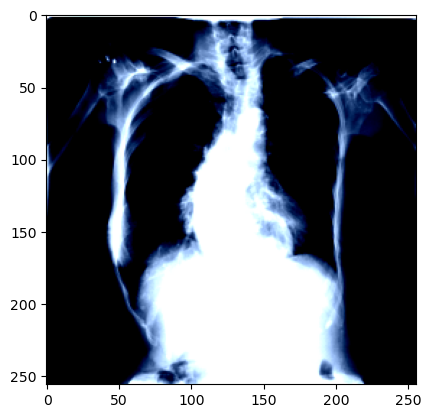

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])


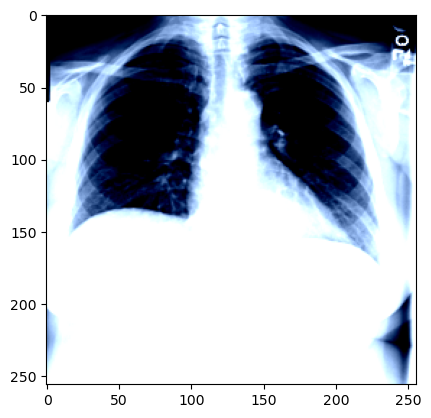

In [16]:
for i in range(20):
    image = test_dataset_nih[i][0]
    image = np.transpose(image, (1, 2, 0))  # Transpose to (256, 256, 3) for color display
    target = test_dataset_nih[i][1]
    print(target)
    pathology = test_df_nih["Finding Labels"][i]
    index = test_df_nih["index"][i]
    plt.imshow(image)
    plt.show()

In [17]:
train_dataloader_nih = DataLoader(train_dataset_nih, batch_size=32, shuffle=True, pin_memory=True)
val_dataloader_nih = DataLoader(val_dataset_nih, batch_size=32, shuffle=True, pin_memory = True)
test_dataloader_nih = DataLoader(test_dataset_nih, batch_size=32, shuffle=True, num_workers=12, pin_memory=True)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

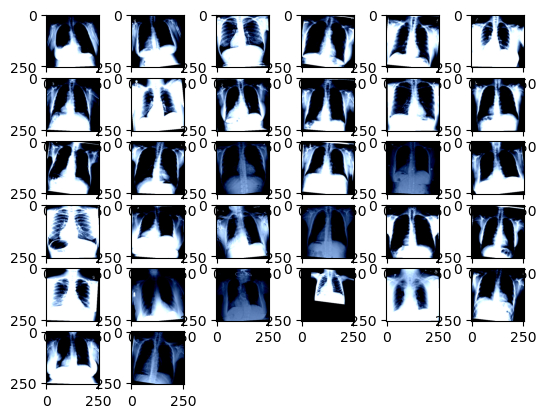

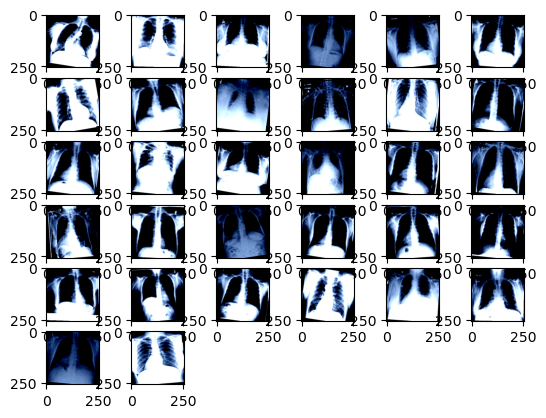

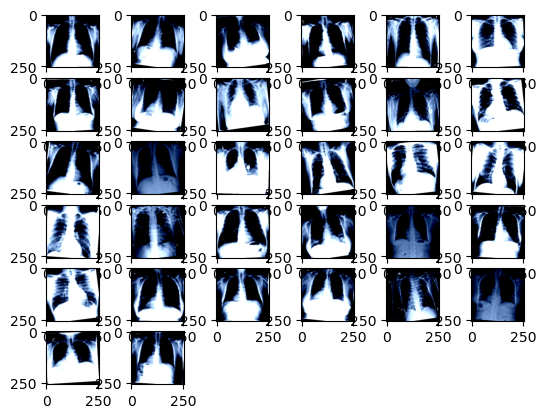

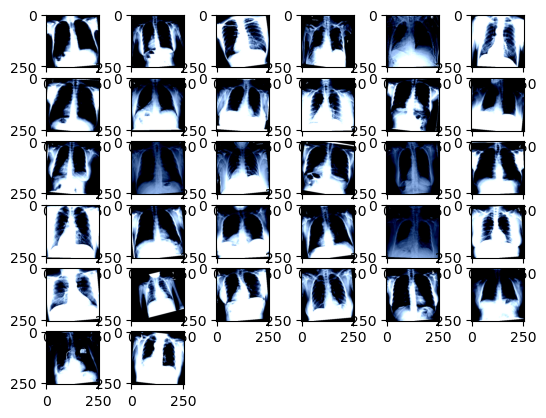

In [18]:
for j,data in enumerate(train_dataloader_nih):
    plt.figure()
    img_batch = data[0]
    for k in range(len(img_batch)):
        img = img_batch[k].numpy()
        transform = transforms.Lambda(lambda x: x.transpose((1, 2, 0)))
        img = transform(img)
        plt.subplot(round(np.sqrt(len(img_batch))), round(np.sqrt(len(img_batch))), k+1)
        plt.imshow(img, cmap = 'gray')
    j += 1
    if j==4:
        break

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

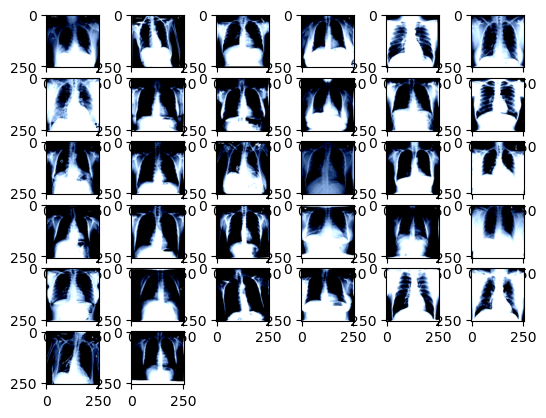

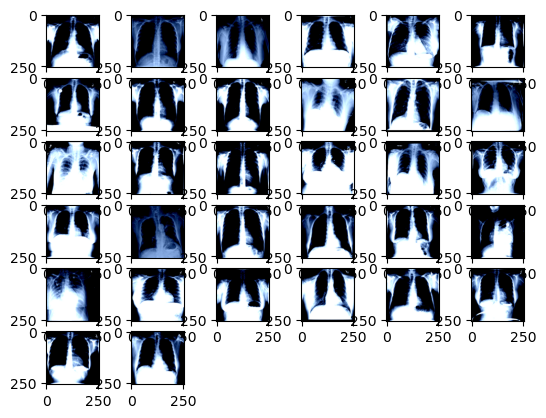

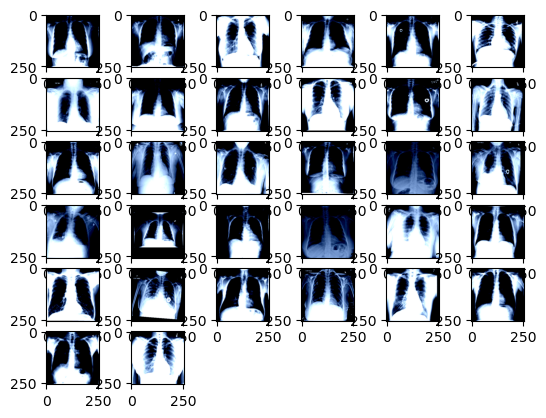

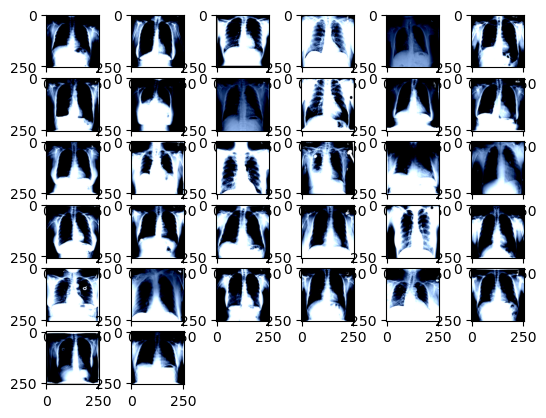

In [19]:
for j,data in enumerate(val_dataloader_nih):
    plt.figure()
    img_batch = data[0]
    for k in range(len(img_batch)):
        img = img_batch[k].numpy()
        transform = transforms.Lambda(lambda x: x.transpose((1, 2, 0)))
        img = transform(img)
        plt.subplot(round(np.sqrt(len(img_batch))), round(np.sqrt(len(img_batch))), k+1)
        plt.imshow(img, cmap = 'gray')
    j += 1
    if j==4:
        break

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

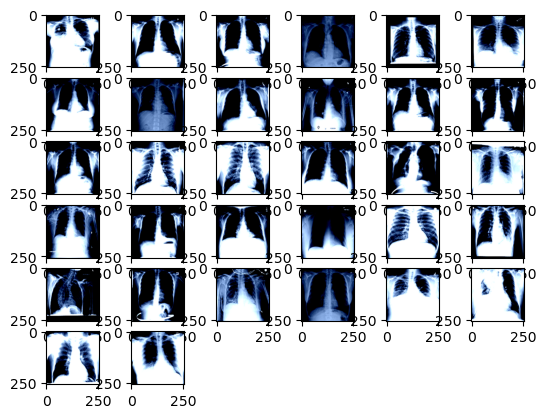

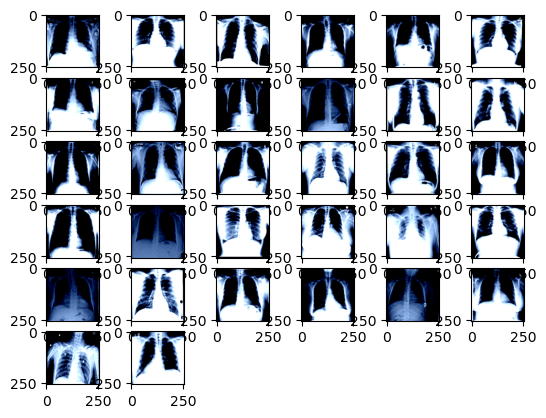

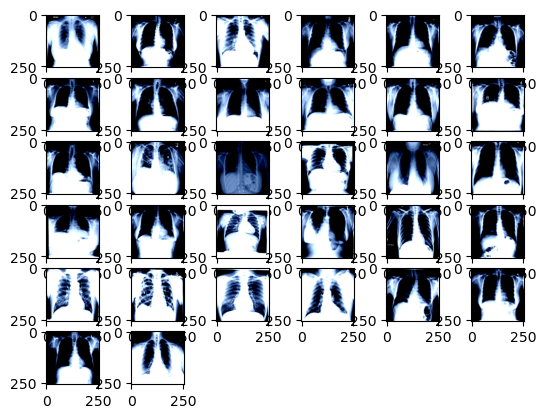

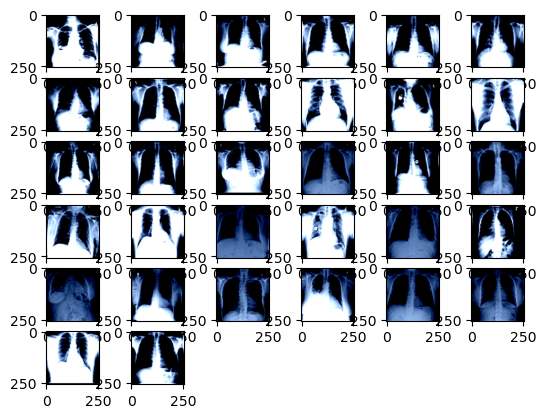

In [20]:
for j,data in enumerate(test_dataloader_nih):
    plt.figure()
    img_batch = data[0]
    for k in range(len(img_batch)):
        img = img_batch[k].numpy()
        transform = transforms.Lambda(lambda x: x.transpose((1, 2, 0)))
        img = transform(img)
        plt.subplot(round(np.sqrt(len(img_batch))), round(np.sqrt(len(img_batch))), k+1)
        plt.imshow(img, cmap = 'gray')
    j += 1
    if j==4:
        break

In [21]:
cxp_csv_train_file = "/mnt/disk1/chexpertchestxrays-u20210408/train.csv"
cxp_csv_val_file = "/mnt/disk1/chexpertchestxrays-u20210408/valid.csv"

In [22]:
cxp_train_csv = pd.read_csv(cxp_csv_train_file)
cxp_val_csv = pd.read_csv(cxp_csv_val_file)

In [23]:
cxp_train_csv['patient_id'] = cxp_train_csv['Path'].apply(lambda x: x.split('/')[2])
cxp_val_csv['patient_id'] = cxp_val_csv['Path'].apply(lambda x: x.split('/')[2])

In [24]:
# Define a function to prioritize "frontal" images
def prioritize_frontal(group):
    frontal_indices = group[group['Path'].str.contains('frontal')].index.tolist()
    return frontal_indices if frontal_indices else group.index.tolist()

In [25]:
# Keep only one image per patient, prioritizing "frontal" images
frontal_patient_indices_train = cxp_train_csv.groupby('patient_id', group_keys=False).apply(prioritize_frontal)
frontal_patient_indices_val = cxp_val_csv.groupby('patient_id', group_keys=False).apply(prioritize_frontal)

In [26]:
frontal_patient_indices_train = [item for sublist in frontal_patient_indices_train for item in sublist]
frontal_patient_indices_val = [item for sublist in frontal_patient_indices_val for item in sublist]

In [27]:
frontal_df_train = cxp_train_csv.loc[frontal_patient_indices_train]
frontal_df_val = cxp_val_csv.loc[frontal_patient_indices_val]

In [28]:
# Keep only one image per patient
unique_patients_df_train = frontal_df_train.drop_duplicates(subset='patient_id', keep='first')
unique_patients_df_val = frontal_df_val.drop_duplicates(subset='patient_id', keep='first')

# Get the indices of the unique patients
unique_patient_indices_train = unique_patients_df_train.index.tolist()
unique_patient_indices_val = unique_patients_df_val.index.tolist()

In [29]:
cxp_train_df =frontal_df_train.loc[unique_patient_indices_train]
cxp_val_df =frontal_df_val.loc[unique_patient_indices_val]

In [30]:
# Assuming cxp_train_df is your DataFrame
# For demonstration purposes, let's create a sample DataFrame

# Replace the beginning of the paths
new_prefix = "train"
cxp_train_df['Path'] = cxp_train_df['Path'].str.replace('^CheXpert-v1\.0/train', new_prefix, regex=True)
cxp_val_df['Path'] = cxp_val_df['Path'].str.replace('^CheXpert-v1\.0/valid', new_prefix, regex=True)

In [31]:
# Concatenate vertically
cxp_df = pd.concat([cxp_train_df, cxp_val_df], axis=0).reset_index(drop = True)

In [32]:
train_patient_indices_cxp = read_indices_from_txt('/home/marina/continual_fairness/datasets_indices/train_indices_cxp.txt')
val_patient_indices_cxp = read_indices_from_txt('/home/marina/continual_fairness/datasets_indices/val_indices_cxp.txt')
test_patient_indices_cxp = read_indices_from_txt('/home/marina/continual_fairness/datasets_indices/test_indices_cxp.txt')

In [33]:
train_df_cxp = cxp_df[cxp_df.index.isin(train_patient_indices_cxp)].reset_index(drop=True)
val_df_cxp = cxp_df[cxp_df.index.isin(val_patient_indices_cxp)].reset_index(drop=True)
test_df_cxp = cxp_df[cxp_df.index.isin(test_patient_indices_cxp)].reset_index(drop=True)

In [34]:
normalize_cxp = transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])

train_transform_cxp = transforms.Compose([transforms.RandomHorizontalFlip(),
                                          transforms.RandomRotation(15),
                                          transforms.Resize((256,256)),
                                          transforms.CenterCrop(256),
                                          transforms.ToTensor(),
                                          normalize_cxp])
val_transform_cxp = transforms.Compose([transforms.Resize(256),
                                        transforms.Resize((256,256)),
                                        transforms.ToTensor(),
                                        normalize_cxp])
test_transform_cxp = transforms.Compose([transforms.Resize((256,256)),
                                         transforms.CenterCrop(256),
                                         transforms.ToTensor(),
                                         normalize_cxp])

In [35]:
path_image_cxp = "/mnt/disk1/chexpertchestxrays-u20210408"

In [36]:
train_dataset_cxp = CheXpert(train_df_cxp, path_image=path_image_cxp, transform = train_transform_cxp)
val_dataset_cxp = CheXpert(val_df_cxp,path_image=path_image_cxp, transform = val_transform_cxp)
test_dataset_cxp = CheXpert(test_df_cxp, path_image=path_image_cxp, transform = test_transform_cxp)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0.,
        0., 0., 1.])


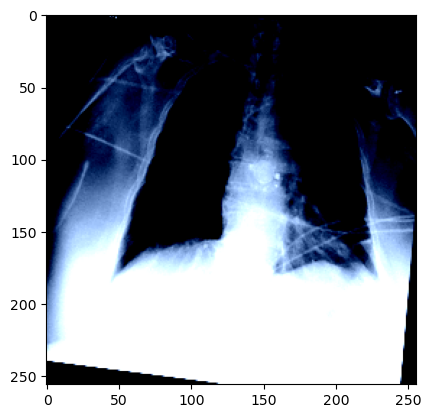

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


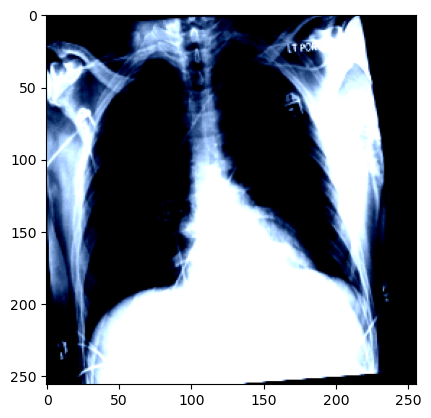

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0.,
        0., 0., 0.])


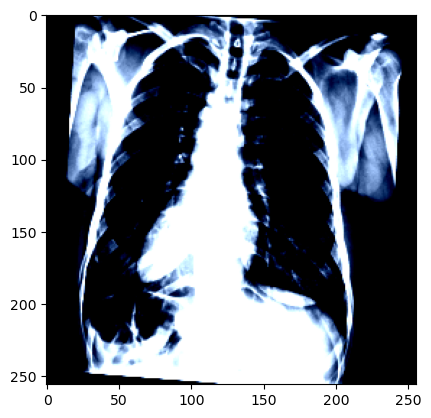

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0.,
        0., 0., 1.])


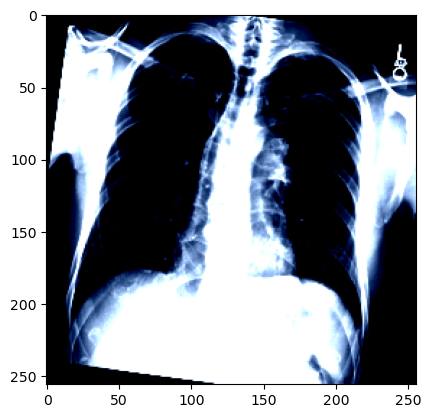

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0.,
        0., 0., 0.])


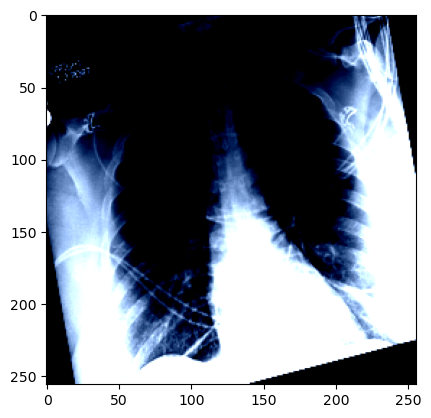

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([1., 1., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 1., 1.])


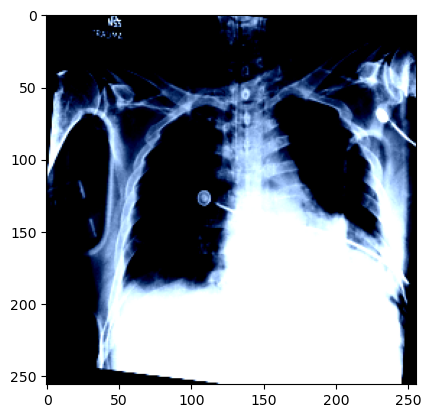

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([1., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 1.])


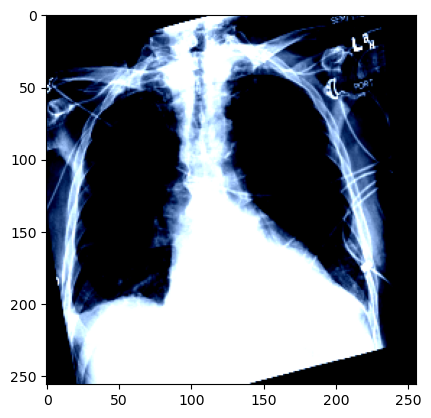

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 1.])


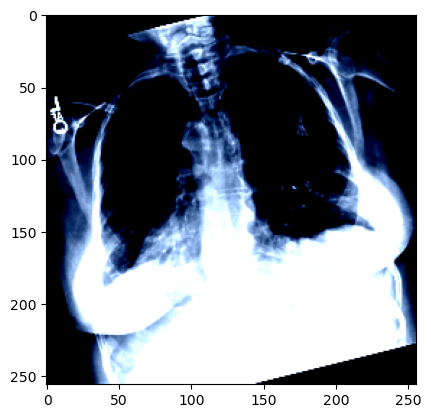

tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0.,
        0., 0., 0.])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


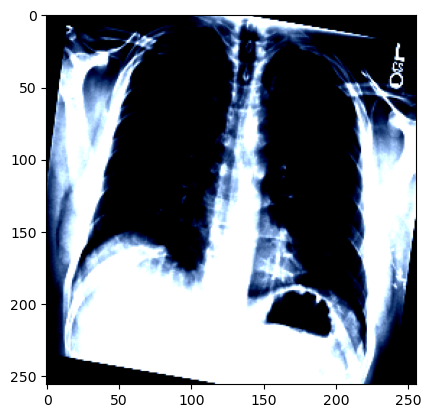

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])


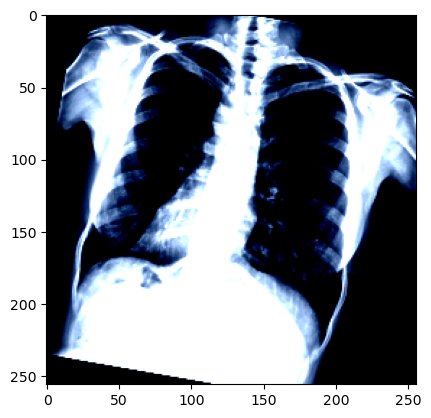

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([1., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


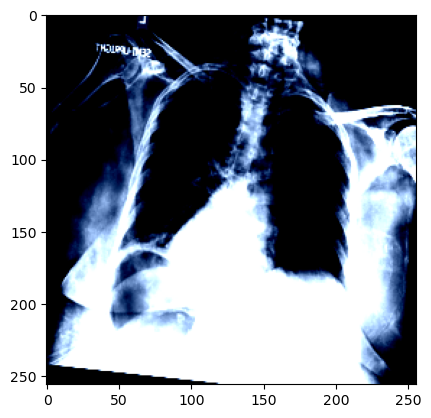

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([1., 0., 0., 1., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 1.,
        0., 0., 0.])


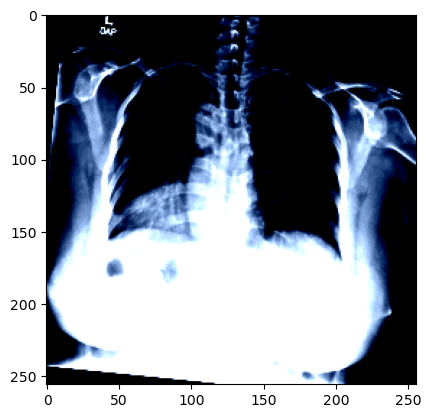

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([1., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


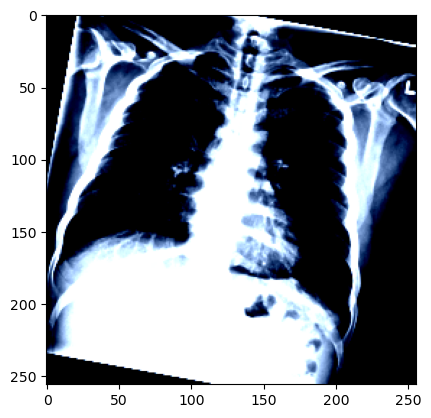

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0.,
        0., 0., 0.])


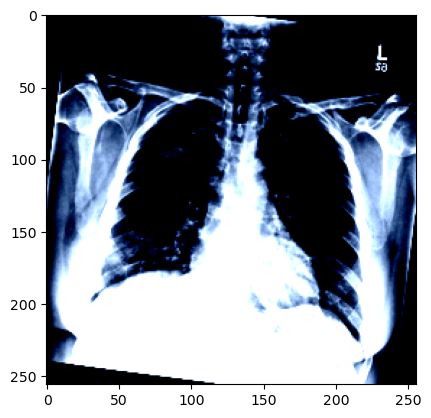

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 1., 0.])


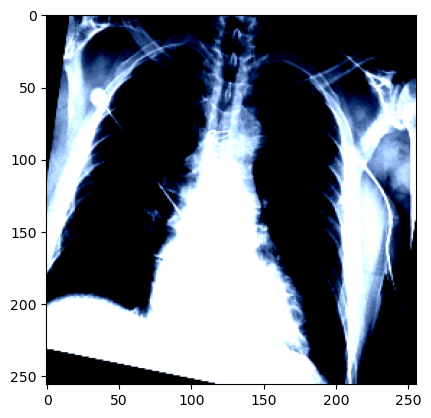

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0.,
        0., 0., 0.])


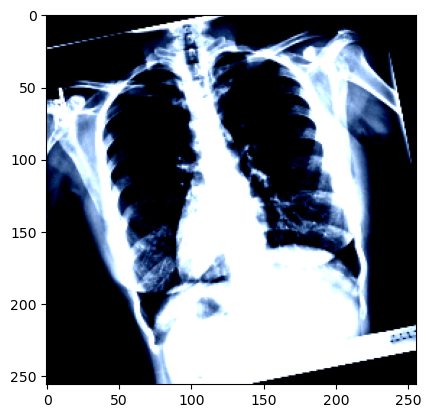

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([1., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 1., 0.])


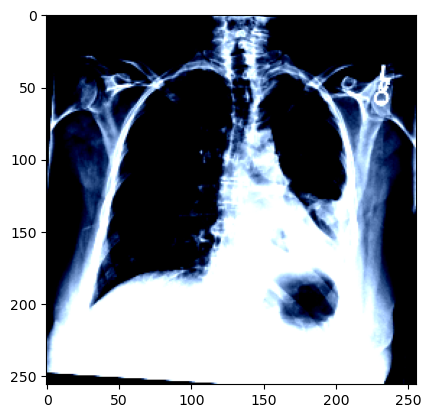

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


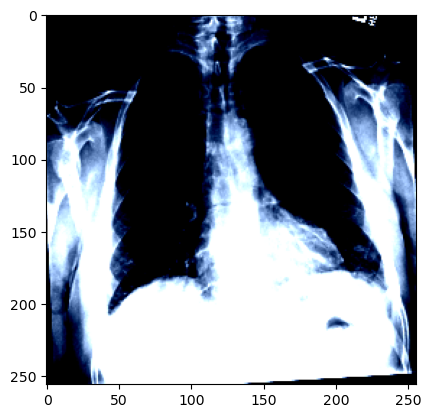

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


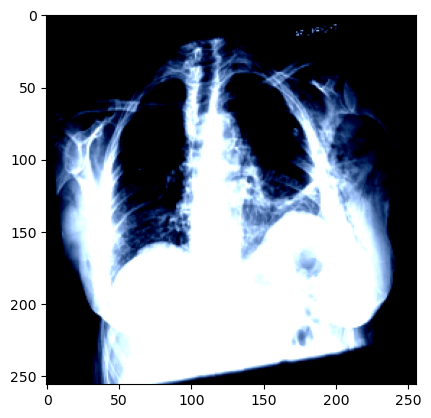

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([1., 1., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 1., 0.])


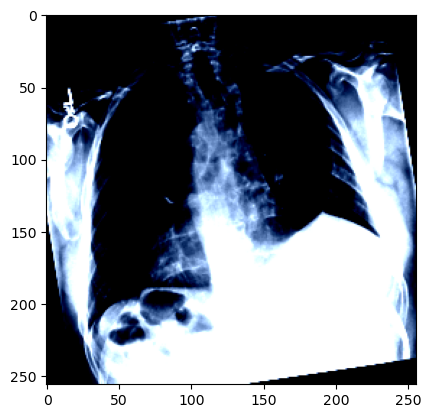

In [37]:
for i in range(20):
    image = train_dataset_cxp[i][0]
    image = np.transpose(image, (1, 2, 0))  # Transpose to (256, 256, 3) for color display
    target = train_dataset_cxp[i][1]
    print(target)
    plt.imshow(image)
    plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([1., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


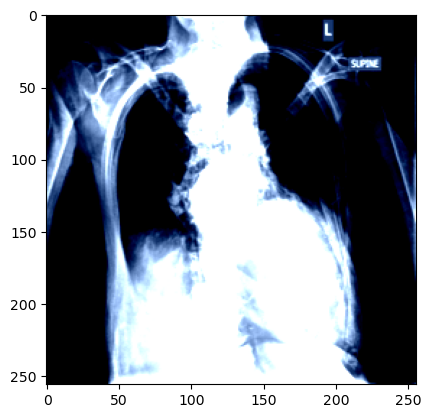

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])


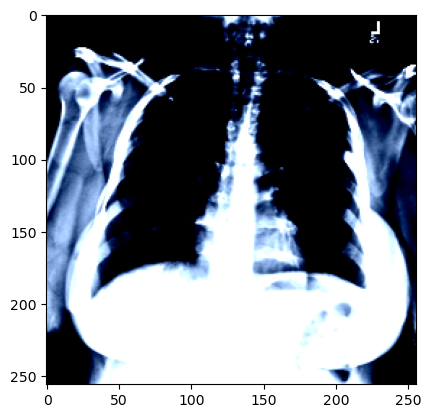

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])


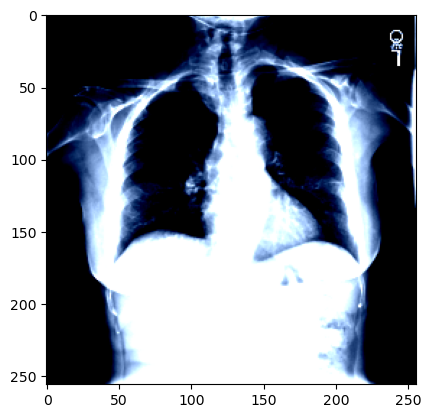

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])


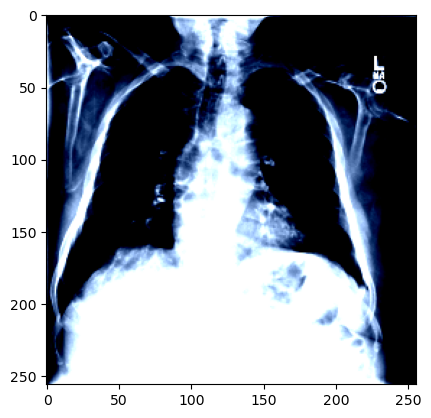

tensor([1., 0., 1., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


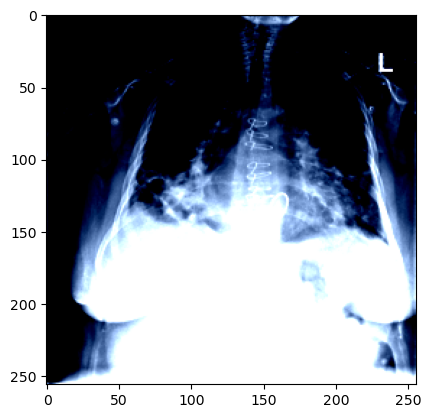

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


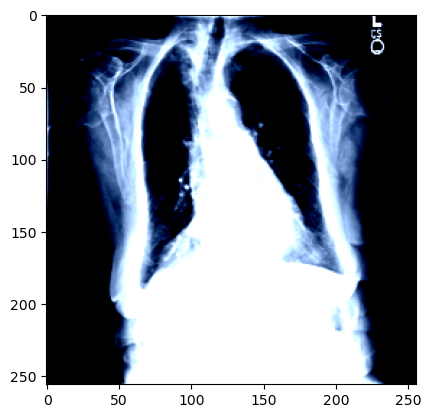

tensor([1., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


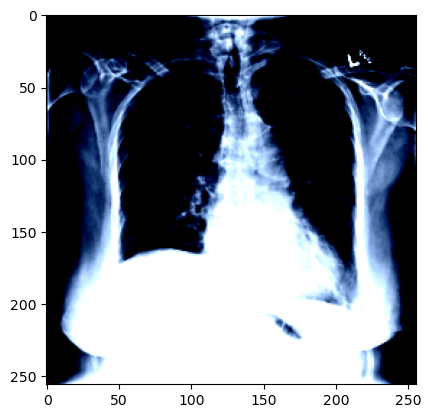

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([1., 0., 1., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 1.])


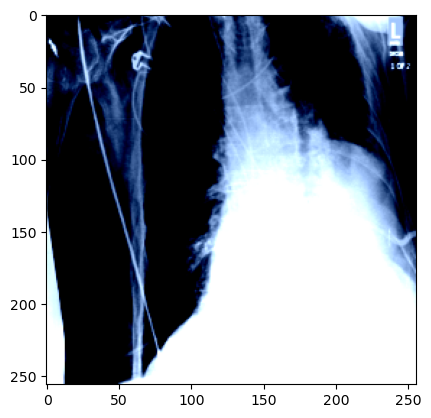

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0.,
        0., 0., 0.])


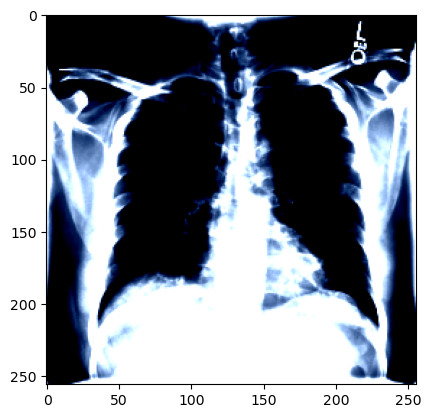

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])


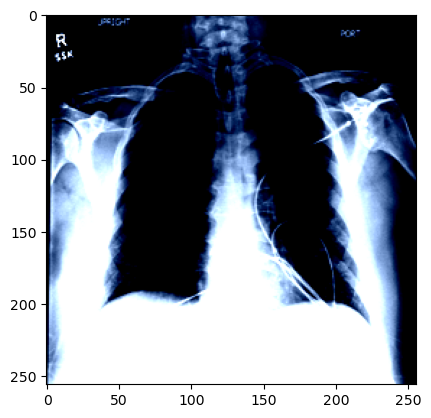

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 1., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


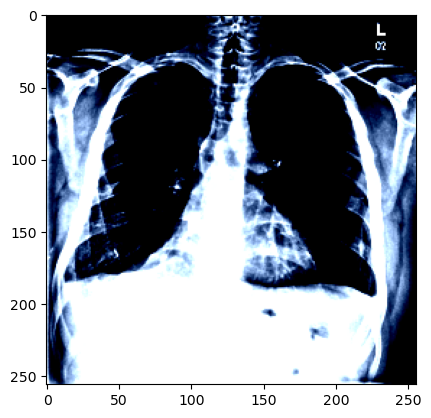

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0.,
        0., 0., 0.])


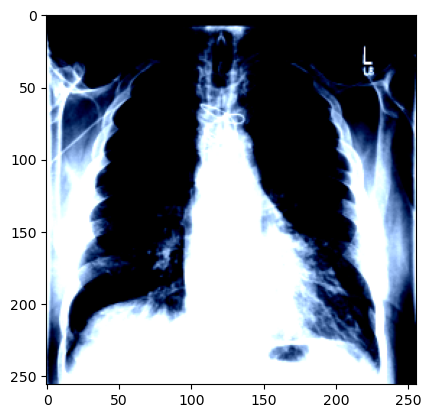

tensor([0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


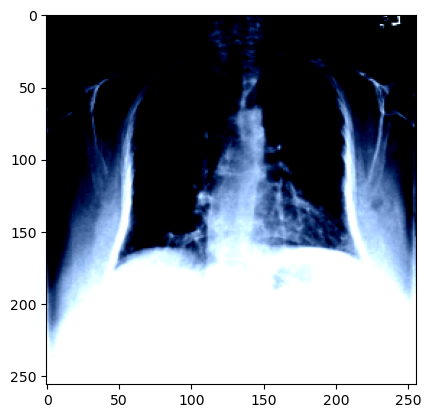

tensor([1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


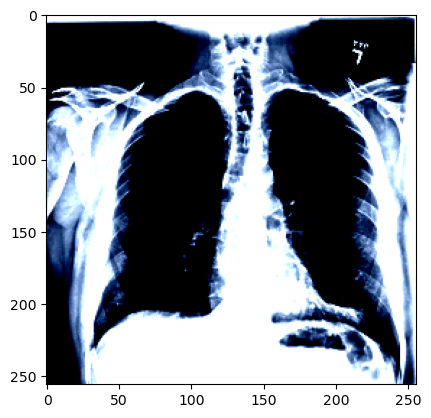

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0.,
        0., 0., 0.])


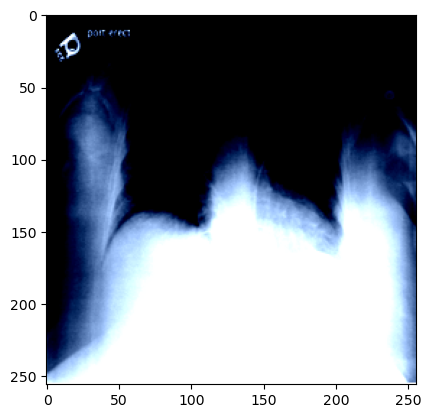

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([1., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0.,
        0., 0., 0.])


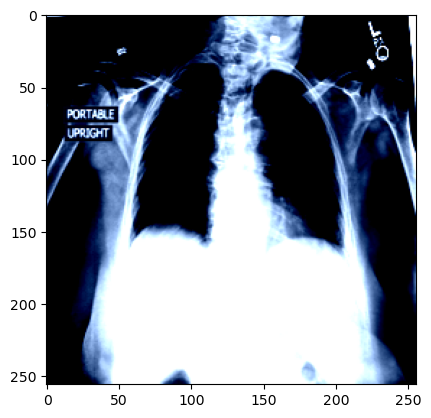

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 1., 0., 1., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


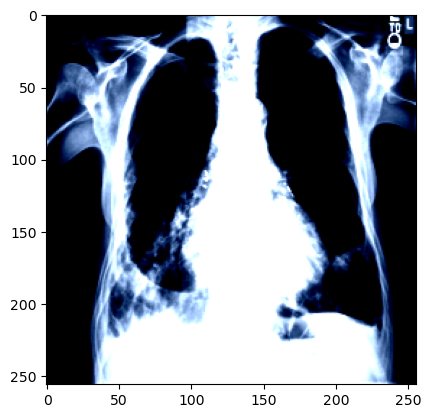

tensor([0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


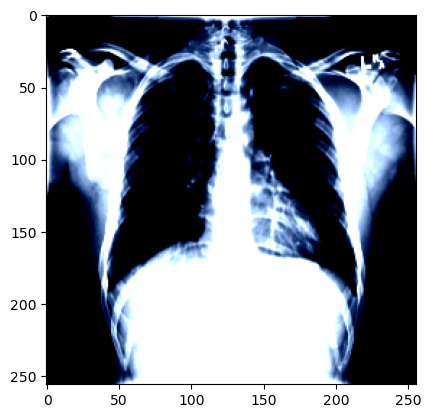

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 1., 0., 0., 0., 1., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


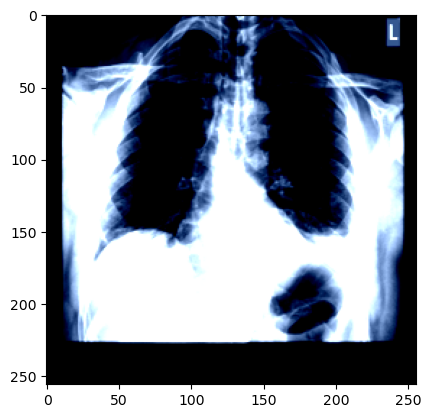

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


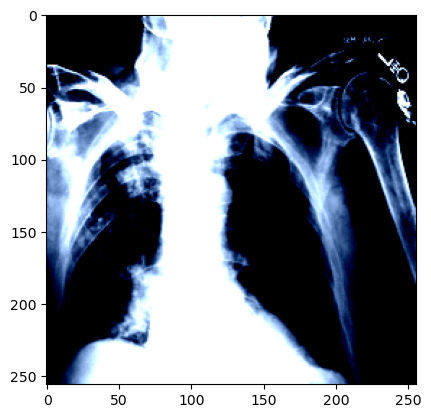

In [38]:
for i in range(20):
    image = val_dataset_cxp[i][0]
    target = val_dataset_cxp[i][1]
    print(target)
    image = np.transpose(image, (1, 2, 0))  # Transpose to (256, 256, 3) for color display
    plt.imshow(image)
    plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 1., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


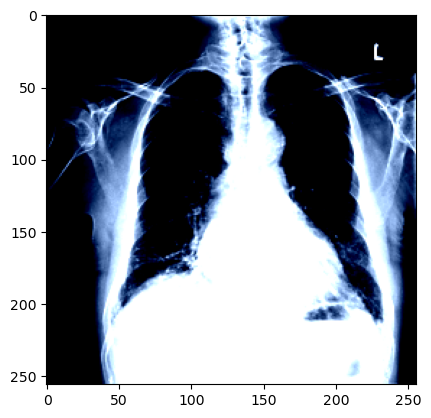

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0.,
        0., 0., 0.])


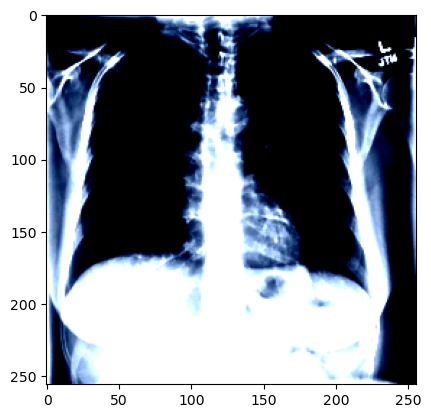

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0.,
        0., 0., 1.])


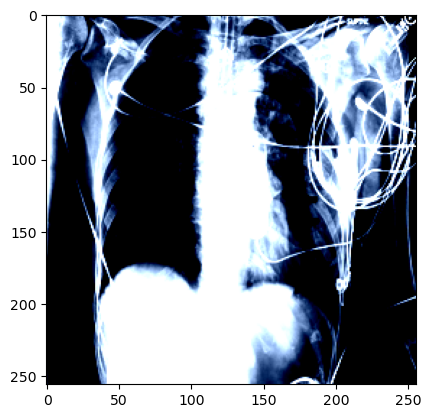

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])


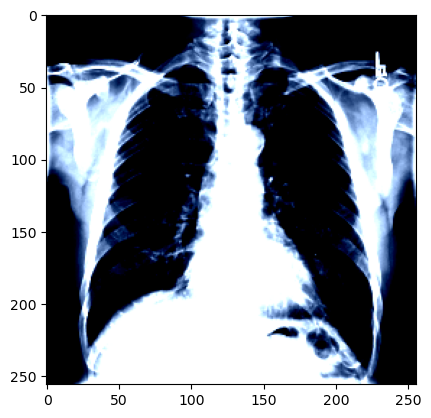

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 1., 0.])


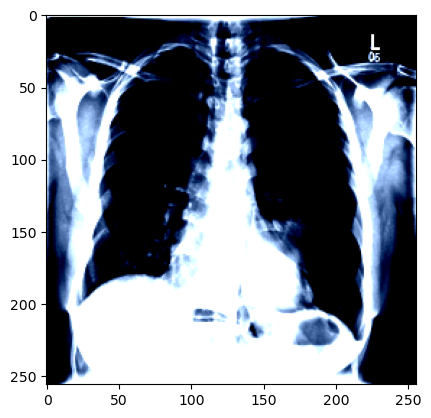

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 1., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 1.])


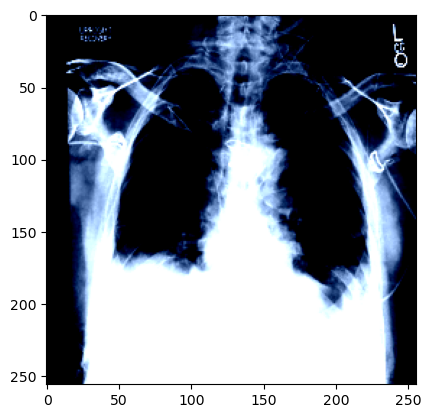

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 1., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 1.])


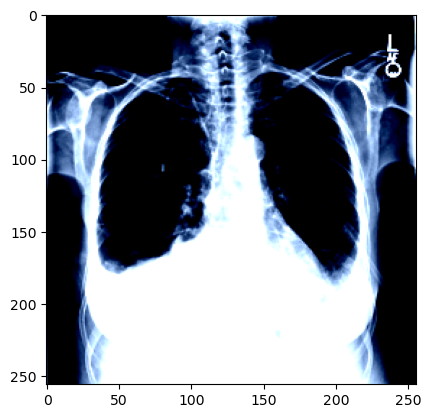

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])


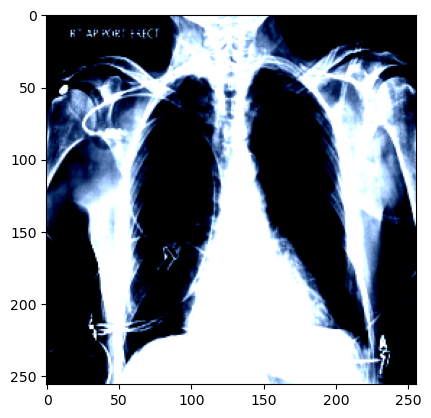

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0.,
        0., 0., 0.])


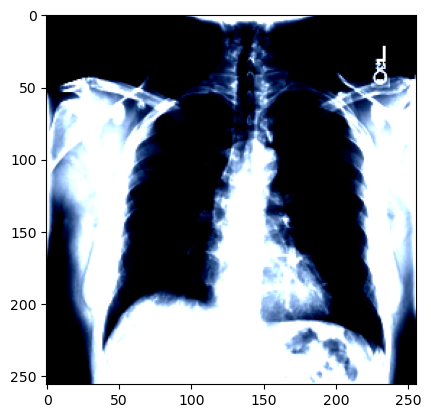

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 1., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1.,
        0., 0., 0.])


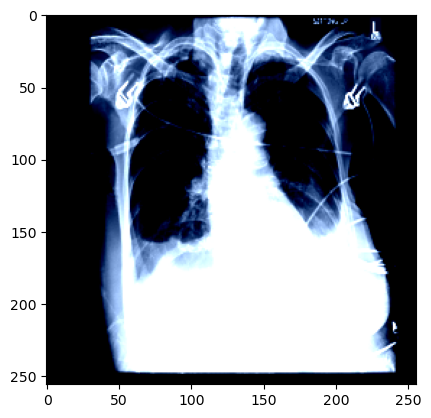

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0.,
        0., 0., 0.])


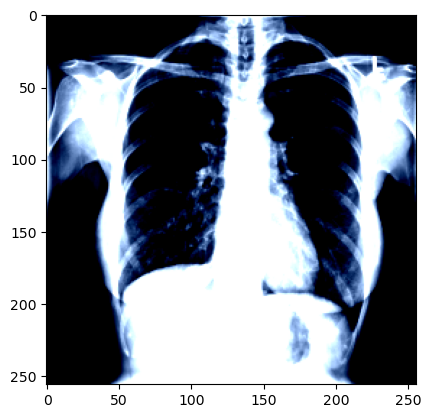

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([1., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


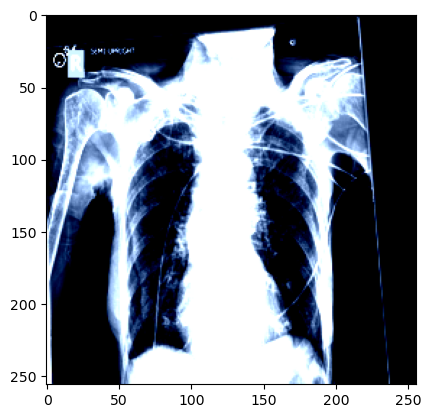

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([1., 0., 0., 0., 1., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


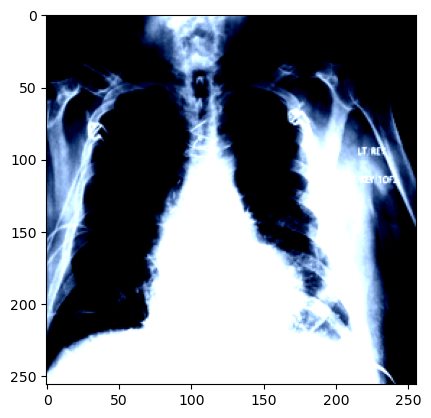

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 1.])


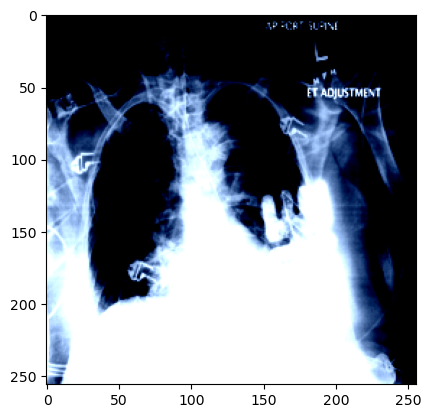

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([1., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 1., 1.])


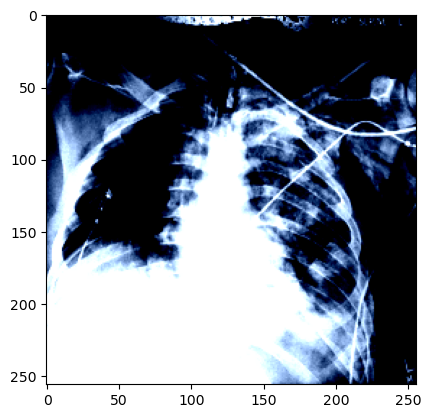

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 1., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 1.])


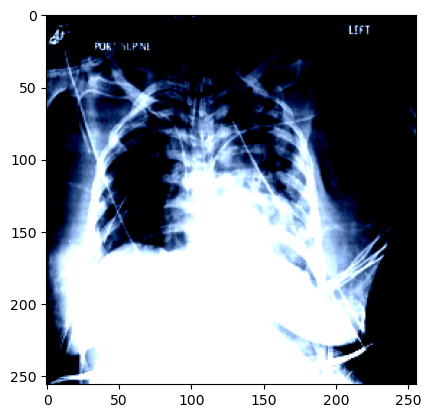

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0.,
        0., 0., 0.])


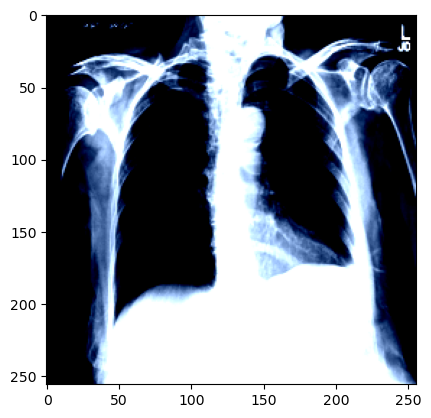

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([1., 0., 1., 0., 0., 1., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 1.])


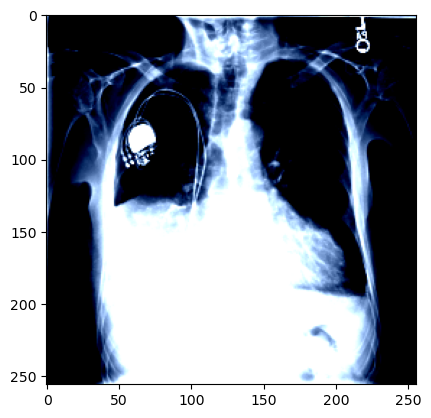

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0.])


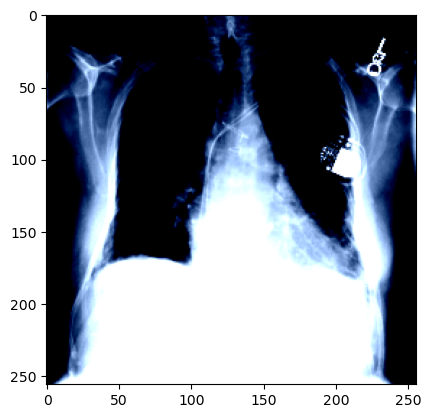

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([1., 0., 0., 0., 1., 1., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0.,
        0., 0., 0.])


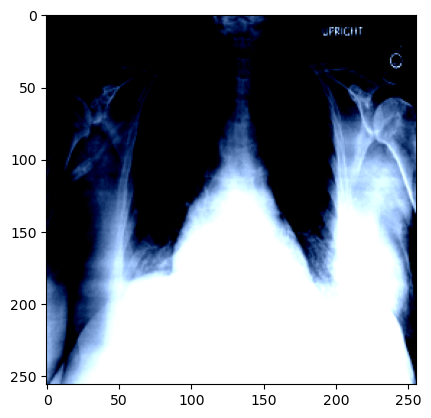

In [39]:
for i in range(20):
    image = test_dataset_cxp[i][0]
    target = test_dataset_cxp[i][1]
    print(target)
    image = np.transpose(image, (1, 2, 0))  # Transpose to (256, 256, 3) for color display
    plt.imshow(image)
    plt.show()

In [40]:
train_dataloader_cxp = DataLoader(train_dataset_cxp, batch_size=48, shuffle=True, num_workers=12, pin_memory=True)
val_dataloader_cxp = DataLoader(val_dataset_cxp, batch_size=48, shuffle=True, num_workers=12, pin_memory=True)
test_dataloader_cxp = DataLoader(test_dataset_cxp, batch_size=48, shuffle=True, num_workers=12, pin_memory=True)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

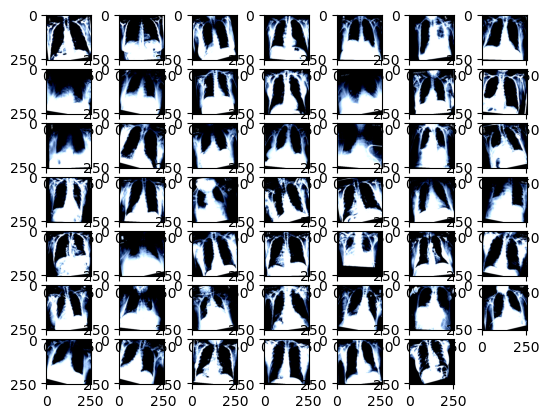

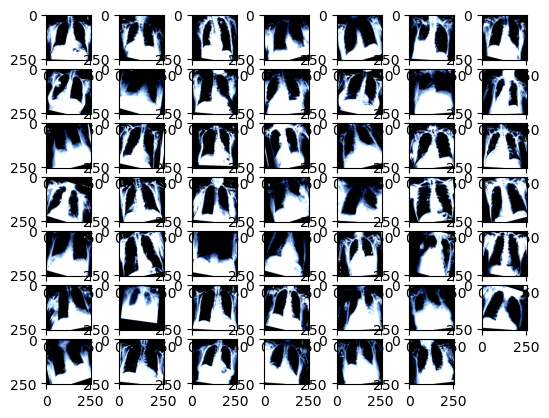

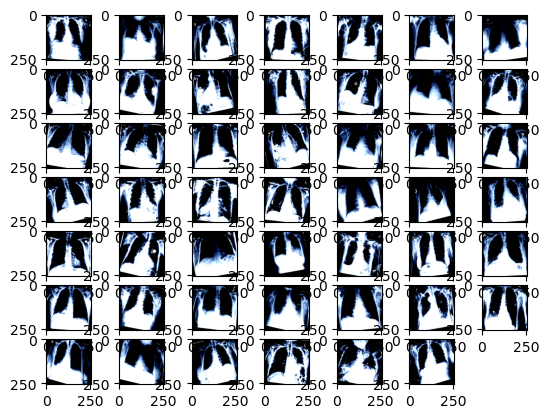

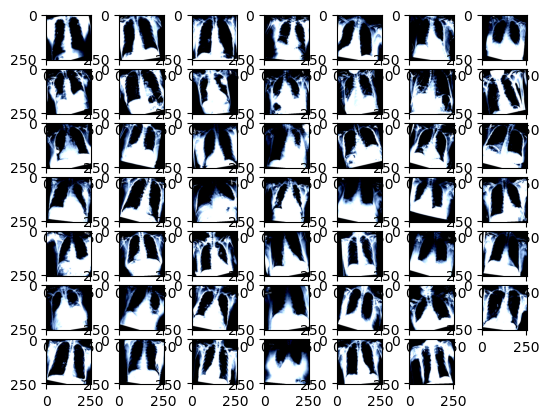

In [41]:
for j,data in enumerate(train_dataloader_cxp):
    plt.figure()
    img_batch = data[0]
    for k in range(len(img_batch)):
        img = img_batch[k].numpy()
        transform = transforms.Lambda(lambda x: x.transpose((1, 2, 0)))
        img = transform(img)
        plt.subplot(round(np.sqrt(len(img_batch))), round(np.sqrt(len(img_batch))), k+1)
        plt.imshow(img, cmap = 'gray')
    j += 1
    if j==4:
        break

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

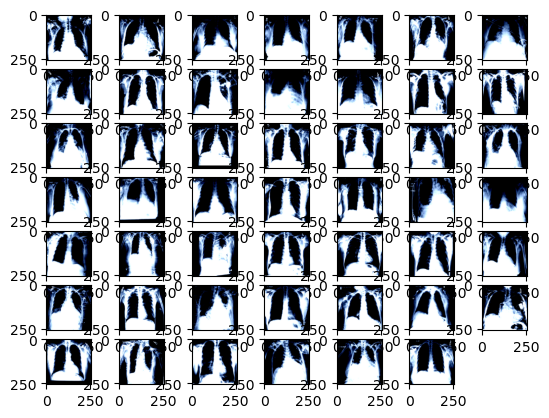

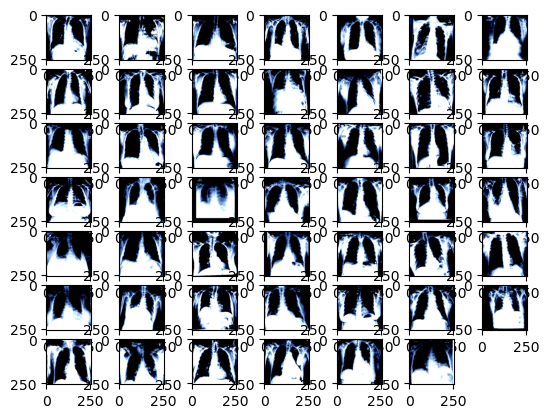

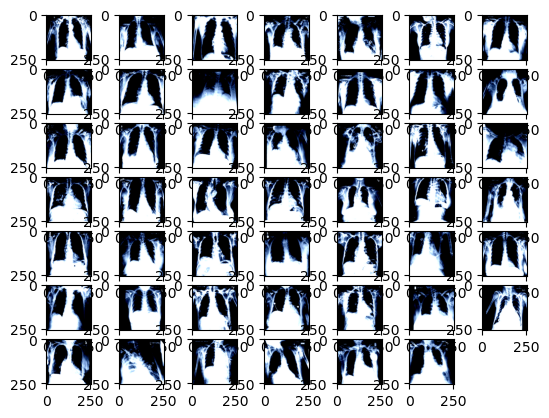

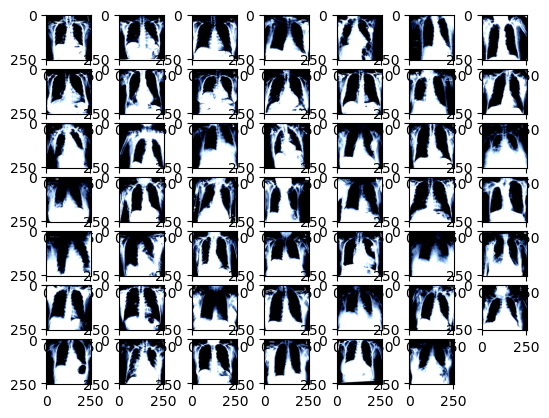

In [42]:
for j,data in enumerate(val_dataloader_cxp):
    plt.figure()
    img_batch = data[0]
    for k in range(len(img_batch)):
        img = img_batch[k].numpy()
        transform = transforms.Lambda(lambda x: x.transpose((1, 2, 0)))
        img = transform(img)
        plt.subplot(round(np.sqrt(len(img_batch))), round(np.sqrt(len(img_batch))), k+1)
        plt.imshow(img, cmap = 'gray')
    j += 1
    if j==4:
        break

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

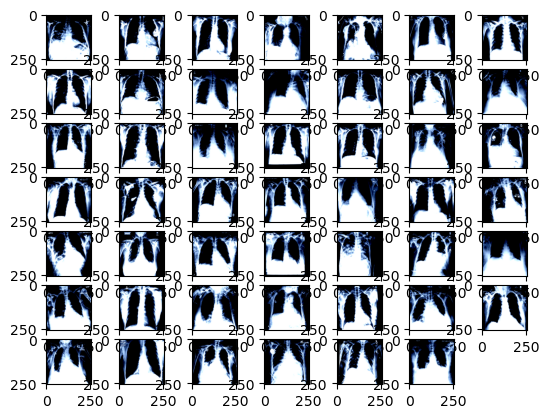

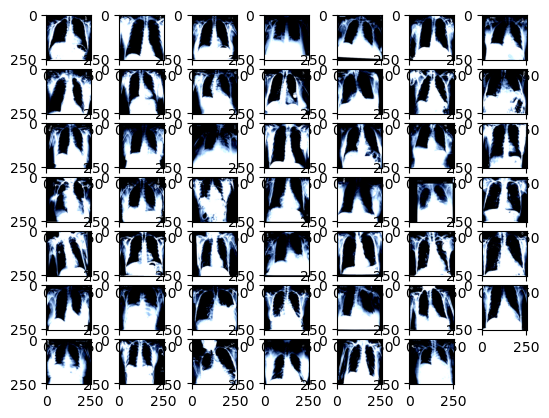

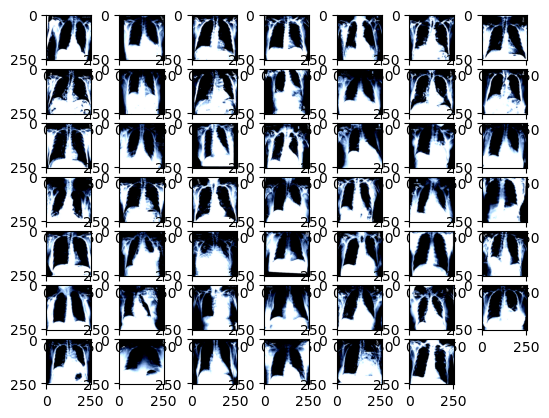

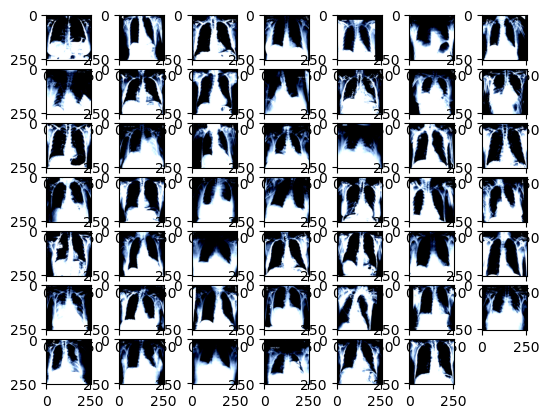

In [43]:
for j,data in enumerate(test_dataloader_cxp):
    plt.figure()
    img_batch = data[0]
    for k in range(len(img_batch)):
        img = img_batch[k].numpy()
        transform = transforms.Lambda(lambda x: x.transpose((1, 2, 0)))
        img = transform(img)
        plt.subplot(round(np.sqrt(len(img_batch))), round(np.sqrt(len(img_batch))), k+1)
        plt.imshow(img, cmap = 'gray')
    j += 1
    if j==4:
        break

In [44]:
#"We initialize a 121-layer DenseNet with pre-trained weights from ImageNet"
model = torch.hub.load('pytorch/vision:v0.10.0', 'densenet121', pretrained=True)
#go from a classification of 1014 classes to classification of 14 classes gradually with dropout(stack of two linear layers)
model.classifier = nn.Sequential(
    nn.Linear(1024, 21),
    #"The output of the network is an array of 14 numbers between 0 and 1 indicating the probability of each disease label."
    nn.Sigmoid()
)
#"multi-label binary cross entropy loss"
criterion = torch.nn.BCELoss()
#"We use Adam28 optimization with default parameters", "best initial LR is 0.0005 "
optimizer = optim.Adam(model.parameters(), lr=0.0005)

Using cache found in /home/marina/.cache/torch/hub/pytorch_vision_v0.10.0


In [45]:
model.to(device)

DenseNet(
  (features): Sequential(
    (conv0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (norm0): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu0): ReLU(inplace=True)
    (pool0): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (denseblock1): _DenseBlock(
      (denselayer1): _DenseLayer(
        (norm1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu1): ReLU(inplace=True)
        (conv1): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (norm2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu2): ReLU(inplace=True)
        (conv2): Conv2d(128, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      )
      (denselayer2): _DenseLayer(
        (norm1): BatchNorm2d(96, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu

In [46]:
tasks_labels = tasks_labels = [[0, 1, 2, 3, 4, 5, 7, 9, 12, 15, 17, 18, 19, 20],[1, 2, 3, 4, 5, 6, 8, 10, 11, 13, 14, 16, 18, 19]]

In [47]:
def filter_target(target, task_labels, device):
    new_target = torch.zeros((target.size(0),len(task_labels))).to(device)
    for i in range(target.size(0)):
        for j in range(len(task_labels)):
            new_target[i][j] = target[i][task_labels[j]]
    return new_target

In [48]:
#variable needed to stop learning if the validation loss doesn't improve over ten epochs
epochs_no_improve = 0

#initialize the best validation loss to the highest possible value
best_val_loss = float('inf')

In [49]:
num_pathologies = 21

In [50]:
output_file = "/home/marina/continual_fairness/output/Training_LwF.txt"

In [51]:
state_dict = torch.load('/home/marina/continual_fairness/models/model_Chexpert_epoch9.pth')
model.load_state_dict(state_dict)

<All keys matched successfully>

In [59]:
class LwFPlugin():
    def __init__(self, alpha, temperature):
        super().__init__()

        if not isinstance(alpha, (float, list)):
            raise ValueError("alpha must be a float or a list of floats.")
        #alpha is a list of values which weight each task while computing the distillation loss.
        #the temperature is the hyper parameter that handles the stability-plasticity trade-off. It weights the distillation loss (cumulative on all past tasks) with respect to the loss on the current task.
        #old_targets is a dictionary used to store the soft targets resulting from applying a model trained on the current task to the dataset. These soft targets are used to compute the distillation loss while training on new tasks.
        #the distillation loss measures how much the model is different from the models that were optimal on past tasks. We chose the binary cross entropy since the chosen setting is multi-label
        self.alpha = alpha
        self.temperature = temperature
        self.old_targets = {}
        self.distillation_loss = nn.BCELoss()

    #this function is called after finding the optimal model for a task, hence after the final epoch. It stores in the old_targets dictionary the soft targets resulting from applying the optimal model for the current task on the whole dataset.
    def after_training_epoch(self, strategy, **kwargs):
        print("Storing output targets in the dictionary")
        #parameters passed as input when calling the "train" function of the strategy
        model = strategy.model
        device = strategy.device
        #tasks_labels = strategy.tasks_labels
        #task_idx = strategy.task_idx - 1
        
        # Set the model to evaluation mode
        model.eval()
        
        #old_targets is a dictionary that contains other dictionaries, one for each past task, where the task id is the key
        #a new dictionary for the current task is created inside old_tasks
        
        with torch.no_grad():
            #we consider every sample in the dataset
            for i in range(len(strategy.task)):
                #create a batch containing one image so that it can be given as input to the model
                image_list = []
                image = strategy.task[i][0].to(device)
                image_list.append(image)
                image_batch = torch.stack(image_list).to(device)
                
                #index of the sample, which is going to be used as key for the dictionary inside old_targets
                sample_idx = strategy.task[i][2]

                # Forward pass through the model
                output = model(image_batch)

                # the key for the dictionary inside old_targets is the sample index, the value is the output of the model
                self.old_targets[sample_idx] = output[0]
                #print every 1000 samples
                if i % 10000 == 9999:
                    print(f"Stored {i} samples")
     
    #this function is called while training on a task (not the first one) after every forward pass, to compute the loss as the combination between the loss on the current task and the distillation loss on past tasks
    def after_backward(self, strategy, mb_indices, mb_output, loss, **kwargs):
        #parameters passed as input when calling the "train" function of the strategy
        model = strategy.model
        device = strategy.device
        current_task = strategy.task
        tasks_labels = strategy.tasks_labels
        
        # Set the model to evaluation mode
        model.eval()

        # Retrieve the model outputs of previous experiences
        old_targets = self.old_targets
        num_prev_tasks = strategy.task_idx

        # Get the minibatch predictions of the current model
        current_output_batch = mb_output
                    
        # Compute the distillation loss
        dist_loss = 0.0

        #for prev_output_batch in old_targets.items():
            #we compare each prev_output_batch with the current mb_output, considering only the samples in mb_output, and only the classes relative to past tasks
        alpha = self.alpha
            #prev_output_batch is a dictionary, by computing prev_output_batch[0] we extract its key
        #old_task_idx = prev_output_batch[0]
        old_tasks_labels = []
        for i in range(num_prev_tasks):
            for j in range(len(tasks_labels[i])):
                old_tasks_labels.append(tasks_labels[i][j])
                
        old_tasks_labels.sort()
            #filter the targets of mb_output in order to consider only the classes of the past task taken into consideration
        new_current_output_batch = filter_target(current_output_batch, old_tasks_labels, device)
            #the dictionary of samples indices as keys and soft targets as value is extracted by executing prev_output_batch[1]
        #new_prev_output_batch = prev_output_batch[1]
            
        i = 0
        for index in mb_indices: #mb_indices contains the indices relative to the current minibatch
            #task_labels = tasks_labels[old_task_idx]
            #extract the target relative to the past task by filtering the target saved in memory in order to consider only the classes of the past task
            prev_output = torch.zeros(len(old_tasks_labels)).to(device)
            for j in range(len(old_tasks_labels)):
                prev_output[j] = old_targets[index][old_tasks_labels[j]]
            current_output = new_current_output_batch[i]
            i += 1
            #compute the distillation loss between the two filtered targets
            dist_loss += alpha * self.distillation_loss(current_output, prev_output)

        # Scale the distillation loss by the number of previous experiences
        dist_loss /= len(mb_output)
        #weight it by the temperature
        dist_loss *= self.temperature

        #add the value to the overall loss
        loss += dist_loss

class LwFStrategy():
    def __init__(
        self,
        model=None,
        optimizer=None,
        alpha=1,
        temperature=2,
        train_epochs=1,
        device=None,
        criterion =None,
        plugins=None,
        **base_kwargs
    ):
        self.model = model  # Set model as an attribute
        self.optimizer = optimizer  # Set optimizer as an attribute
        self.criterion = criterion
        self.device = device
        self.alpha = alpha
        self.temperature = temperature
        self.train_epochs = train_epochs
        
        if self.model is None:
            self.model = torch.hub.load('pytorch/vision:v0.10.0', 'densenet121', pretrained=True)
            
        if self.optimizer is None:
            self.optimizer = optim.Adam(self.model.parameters(), lr=0.0005)
            
        if self.criterion is None:
            self.criterion = torch.nn.BCELoss()
            
        lwf = LwFPlugin(alpha, temperature)
        
        if plugins is None:
            self.plugins = [lwf]
        else:
            self.plugins.append(lwf)
        

        #super().__init__(
            #model,
            #optimizer,
            #train_epochs=train_epochs,
            #device=device,
            #plugins=plugins,
            #**base_kwargs
        #)

    
    def train(self, train_dataloader, dataset, tasks_labels, task_idx, val_dataloader, output_file, original_lr, *args, **kwargs):

        # Create an instance of OutputCapturer to capture the printed output
        with OutputCapturer(output_file) as output_capturer:

            #Train the model on the given task using the specified data loader. Compute the validation loss on the validation dataset after every epoch, evaluate the best model for each task on the test set after completing the training on the task.
            self.task = dataset
            self.task_idx = task_idx
            if self.task_idx > 0:
                self.plugins[0].after_training_epoch(self, **kwargs)
                print("All samples saved in memory")
            self.tasks_labels = tasks_labels
            criterion = self.criterion
            #variable needed to stop learning if the validation loss doesn't improve over ten epochs
            epochs_no_improve = 0

            #initialize the best validation loss to the highest possible value
            best_val_loss = float('inf')
            #the method is called on each experience separately

            #training loop:
            for epoch in range(self.train_epochs):
                self.model.train()
                running_loss = 0
                for mb_idx, mb_data in enumerate(train_dataloader):
                    #extract the image and target of the current minibatch
                    mb_x = mb_data[0].to(self.device)
                    mb_y = mb_data[1].to(self.device)
                    #extract the indices of the current minibatch
                    mb_indices = mb_data[2]
                    #filter the target in order to compute the loss considering only the classes of the current task
                    new_mb_y = filter_target(mb_y, self.tasks_labels[self.task_idx], self.device)

                    #forward pass
                    self.mb_output = self.model(mb_x)
                    #filter the output in order to compute the loss considering only the classes of the current task
                    new_mb_output = filter_target(self.mb_output, self.tasks_labels[self.task_idx], self.device)

                    #compute the loss on the filtered target and output
                    self.loss = criterion(new_mb_output, new_mb_y)

                    #if there's at least one past task, we add to the current loss the distillation loss on past tasks
                    if self.task_idx > 0:
                        self.plugins[0].after_backward(
                            strategy = self,
                            mb_indices = mb_indices,
                            mb_output = self.mb_output,
                            loss=self.loss,
                            **kwargs,
                        )

                    self.optimizer.zero_grad()
                    self.loss.backward()
                    self.optimizer.step()
                    running_loss += self.loss.item()
                    if mb_idx % 100 == 99:    # Print every 100 batches
                        print('[%d, %5d] loss: %.3f' % (epoch + 1, mb_idx + 1, running_loss / 100))
                        running_loss = 0.0 
                
                model.eval()
                            
                val_loss = 0.0

                for k,val_data in enumerate(val_dataloader):
                    #extract the current batch
                    val_img = val_data[0].to(device)
                    val_target_batch = val_data[1].to(device)
                    #Forward pass
                    val_output_batch = self.model(val_img)
                    new_target_batch = filter_target(val_target_batch, tasks_labels[task_idx], device)  
                    new_output_batch = filter_target(val_output_batch, tasks_labels[task_idx], device)

                    #computation of the loss
                    loss = criterion(new_output_batch, new_target_batch)
                    #update the overall loss
                    val_loss += loss.item()

                val_loss /= (k+1)
                print("Validation loss: ", val_loss) #average on the number of batches
                

        torch.save(self.model.state_dict(), '/home/marina/continual_fairness/models/model_LwF_task{0}_epoch{1}.pth'.format(self.task_idx,epoch+1))
            
        # Access the captured output
        captured_output_text = output_capturer.captured_output.getvalue()
        return captured_output_text

In [60]:
#initialize the strategy setting the hyperparameters
strategy = LwFStrategy(
    model=model,
    optimizer=optimizer,
    alpha=1.0,
    temperature=2.0,
    train_epochs=9,
    device=device,
    criterion = criterion
)

In [61]:
original_lr = strategy.optimizer.param_groups[0]['lr']
idx = 1
captured_output = strategy.train(train_dataloader_nih, train_dataset_nih, tasks_labels, idx, val_dataloader_nih, output_file, original_lr)

Storing output targets in the dictionary
Stored 9999 samples
Stored 19999 samples
All samples saved in memory
[1,   100] loss: 0.601
[1,   200] loss: 0.570
[1,   300] loss: 0.552
[1,   400] loss: 0.558
[1,   500] loss: 0.563
[1,   600] loss: 0.555
[1,   700] loss: 0.552
Validation loss:  0.13803410153720796
[2,   100] loss: 0.560
[2,   200] loss: 0.555
[2,   300] loss: 0.552
[2,   400] loss: 0.549
[2,   500] loss: 0.540
[2,   600] loss: 0.553
[2,   700] loss: 0.551
Validation loss:  0.1310481259349695
[3,   100] loss: 0.551
[3,   200] loss: 0.548
[3,   300] loss: 0.546
[3,   400] loss: 0.551
[3,   500] loss: 0.551
[3,   600] loss: 0.543
[3,   700] loss: 0.548
Validation loss:  0.13149179564308874
[4,   100] loss: 0.542
[4,   200] loss: 0.546
[4,   300] loss: 0.550
[4,   400] loss: 0.550
[4,   500] loss: 0.544
[4,   600] loss: 0.542
[4,   700] loss: 0.546
Validation loss:  0.13356217941672532
[5,   100] loss: 0.551
[5,   200] loss: 0.542
[5,   300] loss: 0.538
[5,   400] loss: 0.541
[5,

In [65]:
num_classes = 21
num_samples = len(test_dataset_cxp)
task_labels = tasks_labels[0]

In [66]:
#initialize the two matrices with all zero elements
test_outputs = np.zeros((num_classes, num_samples))
test_targets = np.zeros((num_classes, num_samples))

for j,test_data in enumerate(test_dataloader_cxp):
    #extract the current batch
    test_img = test_data[0].to(device)
    test_target = test_data[1].to(device)
    idx_png = test_data[2]

    #Forward pass
    test_output = model(test_img)

    batch_size = test_target.size(0)
    #index of the first sample in the batch (the first batch is saved in the columns from 0 to 31, the second from 32 to 63...)
    index_first_sample = j*batch_size
    #iterate from index_first_sample to index_first_sample + batch_size - 1
    for k in range(0, batch_size):
        for l in range(num_classes):
            test_outputs[l, index_first_sample + k] = test_output[k][l].item()
            test_targets[l, index_first_sample + k] = test_target[k][l].item()

In [67]:
#we initialize the vector of auc scores to have 14 components equal to 0(14 = number of pathologies), in the following only the components corresponding to the pathologies of the relative task will be modified
auc_scores = np.zeros(num_classes)

for pathology in task_labels:
    #consider the whole lines of test_targets and test_outputs relative to the current pathology
    pathology_targets = test_targets[pathology, :]
    pathology_outputs = test_outputs[pathology, :]
    
    auc_score = roc_auc_score(pathology_targets, pathology_outputs)
    auc_scores[pathology] = auc_score

for pathology in task_labels:
    print('Pathology %d AUC: %.3f' % (pathology, auc_scores[pathology]))

# Print average AUC for all pathologies of the task
avg_auc = np.sum(auc_scores)/len(task_labels)

# Flatten the matrices to get a single-dimensional array for AUC calculation
flat_test_targets = test_targets.flatten()
flat_test_outputs = test_outputs.flatten()

# Compute AUC for all pathologies combined
cumulative_auc = roc_auc_score(flat_test_targets, flat_test_outputs)

print("Cumulative AUC: ", cumulative_auc)
print("Average AUC: ", avg_auc)

Pathology 0 AUC: 0.744
Pathology 1 AUC: 0.713
Pathology 2 AUC: 0.814
Pathology 3 AUC: 0.747
Pathology 4 AUC: 0.843
Pathology 5 AUC: 0.890
Pathology 7 AUC: 0.682
Pathology 9 AUC: 0.743
Pathology 12 AUC: 0.756
Pathology 15 AUC: 0.865
Pathology 17 AUC: 0.794
Pathology 18 AUC: 0.746
Pathology 19 AUC: 0.793
Pathology 20 AUC: 0.854
Cumulative AUC:  0.8840775199809694
Average AUC:  0.7845785187230583


In [62]:
num_classes = 21
num_samples = len(test_dataset_nih)
task_labels = tasks_labels[1]

In [63]:
#initialize the two matrices with all zero elements
test_outputs = np.zeros((num_classes, num_samples))
test_targets = np.zeros((num_classes, num_samples))

for j,test_data in enumerate(test_dataloader_nih):
    #extract the current batch
    test_img = test_data[0].to(device)
    test_target = test_data[1].to(device)
    idx_png = test_data[2]

    #Forward pass
    test_output = model(test_img)

    batch_size = test_target.size(0)
    #index of the first sample in the batch (the first batch is saved in the columns from 0 to 31, the second from 32 to 63...)
    index_first_sample = j*batch_size
    #iterate from index_first_sample to index_first_sample + batch_size - 1
    for k in range(0, batch_size):
        for l in range(num_classes):
            test_outputs[l, index_first_sample + k] = test_output[k][l].item()
            test_targets[l, index_first_sample + k] = test_target[k][l].item()

In [64]:
#we initialize the vector of auc scores to have 14 components equal to 0(14 = number of pathologies), in the following only the components corresponding to the pathologies of the relative task will be modified
auc_scores = np.zeros(num_classes)

for pathology in task_labels:
    #consider the whole lines of test_targets and test_outputs relative to the current pathology
    pathology_targets = test_targets[pathology, :]
    pathology_outputs = test_outputs[pathology, :]
    
    auc_score = roc_auc_score(pathology_targets, pathology_outputs)
    auc_scores[pathology] = auc_score

for pathology in task_labels:
    print('Pathology %d AUC: %.3f' % (pathology, auc_scores[pathology]))

# Print average AUC for all pathologies of the task
avg_auc = np.sum(auc_scores)/len(task_labels)

# Flatten the matrices to get a single-dimensional array for AUC calculation
flat_test_targets = test_targets.flatten()
flat_test_outputs = test_outputs.flatten()

# Compute AUC for all pathologies combined
cumulative_auc = roc_auc_score(flat_test_targets, flat_test_outputs)

print("Cumulative AUC: ", cumulative_auc)
print("Average AUC: ", avg_auc)

Pathology 1 AUC: 0.849
Pathology 2 AUC: 0.919
Pathology 3 AUC: 0.745
Pathology 4 AUC: 0.912
Pathology 5 AUC: 0.908
Pathology 6 AUC: 0.868
Pathology 8 AUC: 0.766
Pathology 10 AUC: 0.873
Pathology 11 AUC: 0.656
Pathology 13 AUC: 0.864
Pathology 14 AUC: 0.763
Pathology 16 AUC: 0.783
Pathology 18 AUC: 0.763
Pathology 19 AUC: 0.794
Cumulative AUC:  0.7983587628756637
Average AUC:  0.8186886608619642
